In [1]:
import os
from pathlib import Path
if 'ESMFMKFILE' not in os.environ:
    os.environ['ESMFMKFILE'] = str(Path(os.__file__).parent.parent / 'esmf.mk')
    
import xscen as xs
import xesmf
import xarray as xr
import xclim as xc
from xclim.sdba import loess

import dask
from dask.distributed import Client

import numpy as np
import pandas as pd
import string

import figanos.matplotlib as fg
fg.utils.set_mpl_style('ouranos')

import matplotlib
from matplotlib import pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import seaborn as sns


from xscen import CONFIG
path = 'config/path_part.yml'
config = 'config/config_part.yml'
xs.load_config(path, config, verbose=(__name__ == '__main__'), reset=True)

pcat = xs.ProjectCatalog(CONFIG['project_catalog']['path'])
tdd=CONFIG['tdd']
daskkws = CONFIG['dask'].get('client', {})
ens_name = CONFIG['ens_name'] 

categories={'scenario':'SSP','model':'GCM','reference':'reference','variability':'variability','adjustment':'method', 'total':'total'}
cmaps={'dry_days':'prec_seq',
      'r20mm':'prec_seq',
      'rx1day':'prec_seq',
       'prcptot': "prec_seq",
      'tg_mean':'temp_seq',
      'tx_30':'temp_seq',
      'tx_max':'temp_seq',
      'dlyfrzthw':'misc_seq_3',
      'solidprcptot':'misc_seq_2',
      'heat_wave_total_length':'temp_seq'}
units={'dry_days':'days',
      'r20mm':'days',
      'rx1day':'mm',
       'prcptot': "mm",
      'tg_mean':'K',
      'tx_30':'days',
      'tx_max':'K',
      'dlyfrzthw':'days',
      'solidprcptot':'mm',
      'heat_wave_total_length':'days'}

from pathlib import Path
Path(CONFIG['paths']['figures']).mkdir(parents=True, exist_ok=True)

/exec/jlavoie/.conda/partition/lib/python3.11/site-packages/h5py/__init__.py:36: UserWarning: h5py is running against HDF5 1.14.3 when it was built against 1.14.2, this may cause problems
  _warn(("h5py is running against HDF5 {0} when it was built against {1}, "


# matrix

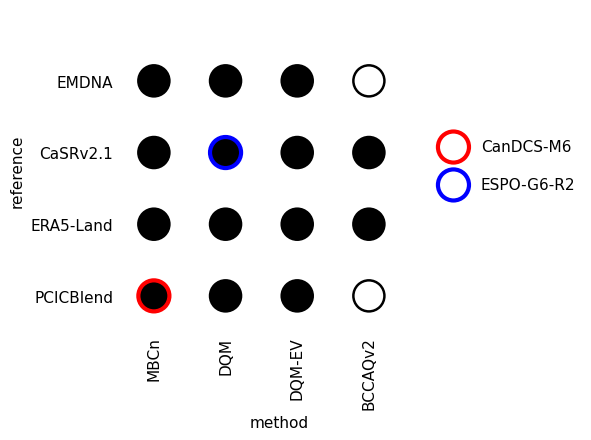

In [2]:

df=pcat.search(**CONFIG['ensemble'][ens_name], processing_level='indicators',variable='prcptot', domain='QC').df

#df_count=df.groupby(['reference', 'adjustment']).size().reset_index(name='count')

# Create all possible combinations of 'reference' and 'adjustment'
all_combinations = pd.MultiIndex.from_product([df['reference'].unique(), df['adjustment'].unique()], 
                                              names=['reference', 'adjustment']).to_frame(index=False)

# Group by 'reference' and 'adjustment' and count occurrences
df_grouped = df.groupby(['reference', 'adjustment']).size().reset_index(name='count')

# Merge with all possible combinations to include missing combinations
df_full = pd.merge(all_combinations, df_grouped, on=['reference', 'adjustment'], how='left').fillna(0)

# Convert 'count' column to integer
df_full['count'] = df_full['count'].astype(int)


df_full=df_full.replace('ESPO-G6','DQM')
df_full=df_full.replace('IC6','DQM-EV')
g = sns.relplot(
    data=df_full,
    x="adjustment", y="reference",hue='count', edgecolor='black', size='count',
    sizes=(5, 5e2), size_norm=(-2,-1),
    legend=False, palette='Greys',
    row_order=['CaSRv2.1','EMDNA','ERA5-Land','PCICBlend']

)
lw=3
plt.scatter(0,0 , marker='o', s=5e2,lw=lw, edgecolor='red', facecolor='none', label='CanDCS-M6')
plt.scatter(1,2 , marker='o', s=5e2,lw=lw, edgecolor='blue', facecolor='none', label='ESPO-G6-R2')

# Tweak the figure to finalize
g.set(aspect="equal")
g.despine(left=True, bottom=True)
plt.xlim((-0.5,4))
plt.ylim((-0.5,4))
g.ax.margins(0.02)
for label in g.ax.get_xticklabels():
    label.set_rotation(90)
plt.legend(bbox_to_anchor=(0.95,0.64),labelspacing=1.5,)
plt.xlabel('method')
plt.grid(visible=False)
g.ax.tick_params(left=False, bottom=False)  # Hides left and bottom ticks
plt.savefig(f"{CONFIG['paths']['figures']}matrix.pdf", bbox_inches='tight')


# example timeseries

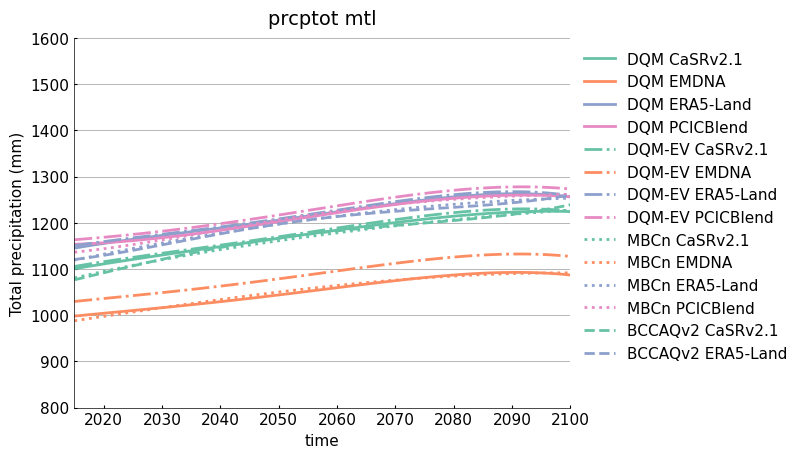

In [3]:

ens_part=pcat.search(processing_level=f'partition-ensemble{ens_name}', variable='prcptot', domain='mtl'
                    ).to_dataset(**tdd)

cmap=sns.color_palette("Set2", as_cmap=True)
n_colors=4

fig=plt.figure()
da=ens_part['prcptot']
fit = da.polyfit(dim="time", deg=4, skipna=True)
sm = xr.polyval(coord=da.time, coeffs=fit.polyfit_coefficients).where(da.notnull())

for a in ['ESPO-G6','IC6','MBCn','BCCAQv2']:
    for r in ['CaSRv2.1','EMDNA','ERA5-Land','PCICBlend']:
        for s in ens_part.scenario.values:
            for m in ens_part.model.values:
                da.sel(adjustment=a,reference=r, scenario=s, model=m).plot(x="time", color='grey',
                                                                           linewidth=0.01, alpha=0.05)

for a, al in zip(['ESPO-G6','IC6','MBCn','BCCAQv2'],['-','-.',':','--']):
    for r, rc in zip(['CaSRv2.1','EMDNA','ERA5-Land','PCICBlend'],[cmap(i) for i in range(n_colors)]):
        if not (a=='BCCAQv2' and r in ['EMDNA','PCICBlend']):
            cur = sm.sel(adjustment=a,reference=r).mean(dim=['model','scenario'])
            cur.plot(color=rc,linestyle=al, label=f"{a} {r}".replace('ESPO-G6','DQM').replace('IC6','DQM-EV'),linewidth=2)
            
            
plt.legend(bbox_to_anchor=(1,1))
plt.title('prcptot mtl')
plt.ylabel('Total precipitation (mm)')
plt.ylim((800,1600))


fig.savefig(f"{CONFIG['paths']['figures']}ts_prcptot_example.pdf", bbox_inches='tight')


# partition grid points


--> The keys in the returned dictionary of datasets are constructed as follows:
	'id.domain.processing_level.xrfreq'


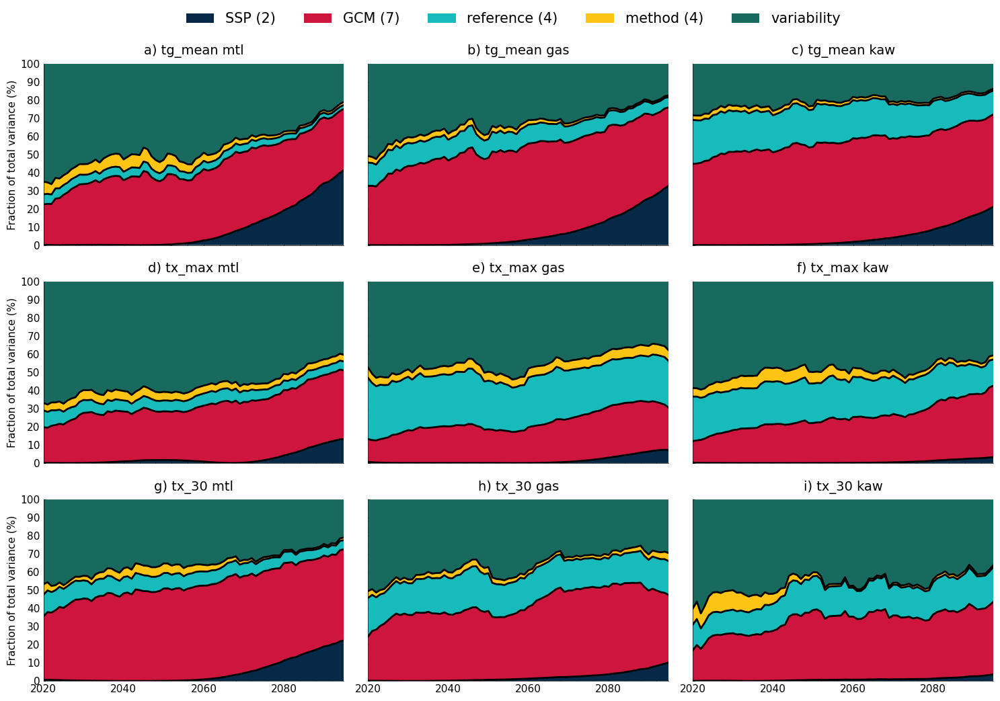

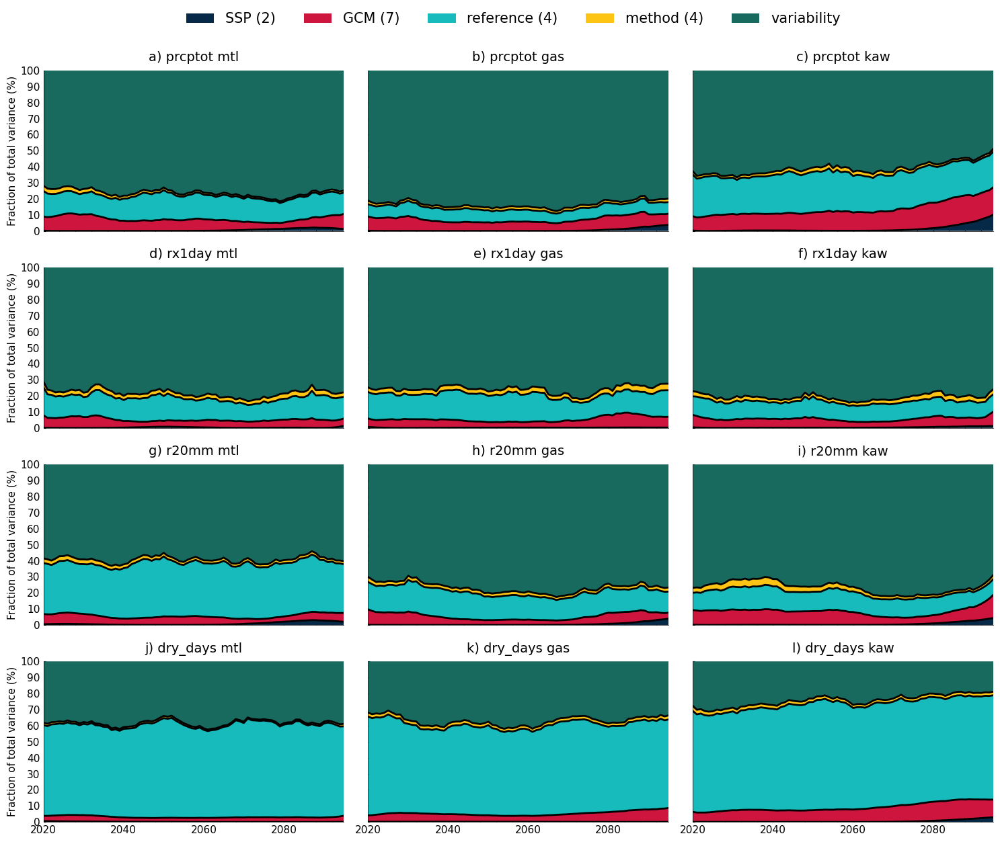

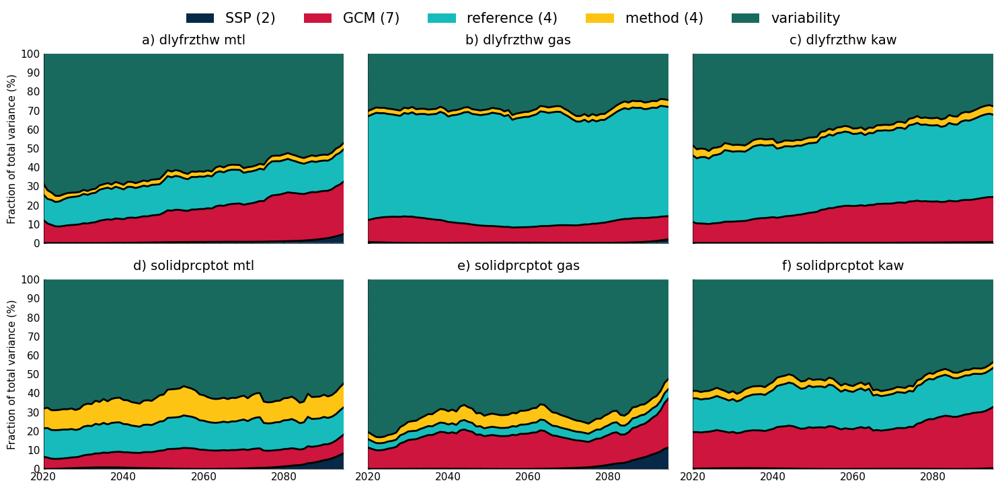

In [4]:
#switch purple and green
matplotlib.rcParams['axes.prop_cycle'] = matplotlib.cycler(color=['#052946', '#ce153d', '#18bbbb', '#fdc414','#196a5e', '#6850af',  '#7a5315']) 

d_wrongorder=pcat.search(processing_level=f'uncertainties{ens_name}-poly-2015', domain=['mtl','gas','kaw'] ).to_dataset_dict(**tdd)

#fix names
for k,v in d_wrongorder.items():
        v['uncertainty']=[categories[x] for x in v['uncertainty'].values]
        for c in categories:
            for var in v.data_vars:
                if c in v[var].attrs:
                    v[var].attrs[categories[c]]=v[var].attrs[c]
#fix order
d={f'CMIP6_ScenarioMIP_mtl.mtl.uncertainties{ens_name}-poly-2015.YS-JAN':d_wrongorder[f'CMIP6_ScenarioMIP_mtl.mtl.uncertainties{ens_name}-poly-2015.YS-JAN'],
   f'CMIP6_ScenarioMIP_gas.gas.uncertainties{ens_name}-poly-2015.YS-JAN':d_wrongorder[f'CMIP6_ScenarioMIP_gas.gas.uncertainties{ens_name}-poly-2015.YS-JAN'],
       f'CMIP6_ScenarioMIP_kaw.kaw.uncertainties{ens_name}-poly-2015.YS-JAN':d_wrongorder[f'CMIP6_ScenarioMIP_kaw.kaw.uncertainties{ens_name}-poly-2015.YS-JAN'],

  }
fig, axs= plt.subplots(3,3, figsize=(15,10), sharex=True, sharey=True)
for i, (id, ds) in enumerate(d.items()):
    domain=ds.attrs['cat:domain']
    for j, var in enumerate(['tg_mean','tx_max','tx_30']):
        frac= xc.ensembles.fractional_uncertainty(ds[var])

#             frac
        fg.partition(frac,show_num=True,ax=axs[j,i])
        axs[j,i].set_title(f"{string.ascii_lowercase[(3*j)+i]}) {var} {domain}")
        axs[j,i].get_legend().remove()
        axs[j,1].set_ylabel('')
        axs[j,2].set_ylabel('')
    
handles, labels = axs[j,i].get_legend_handles_labels()
by_label = dict(zip(labels, handles)).copy()
fig.legend(by_label.values(), by_label.keys(),bbox_to_anchor=(0.85,1.05), ncol=5, fontsize=15)
fig.tight_layout()
fig.savefig(f"{CONFIG['paths']['figures']}tas_unc.pdf", bbox_inches='tight')



fig, axs= plt.subplots(4,3, figsize=(15,12), sharex=True, sharey=True)
for i, (id, ds) in enumerate(d.items()):
    domain=ds.attrs['cat:domain']
    for j, var in enumerate(['prcptot','rx1day', 'r20mm','dry_days']):
        frac= xc.ensembles.fractional_uncertainty(ds[var])
        fg.partition(frac,show_num=True,ax=axs[j,i])
        axs[j,i].set_title(f"{string.ascii_lowercase[(3*j)+i]}) {var} {domain}")
        axs[j,i].get_legend().remove()
        axs[j,1].set_ylabel('')
        axs[j,2].set_ylabel('')
    
handles, labels = axs[j,i].get_legend_handles_labels()
by_label = dict(zip(labels, handles)).copy()
fig.legend(by_label.values(), by_label.keys(),bbox_to_anchor=(0.85,1.05), ncol=5, fontsize=15)
fig.tight_layout()
fig.savefig(f"{CONFIG['paths']['figures']}pr_unc.pdf", bbox_inches='tight')


fig, axs= plt.subplots(2,3, figsize=(15,7), sharex=True, sharey=True)
for i, (id, ds) in enumerate(d.items()):
    domain=ds.attrs['cat:domain']
    for j, var in enumerate(['dlyfrzthw','solidprcptot']): #
        frac= xc.ensembles.fractional_uncertainty(ds[var])
        fg.partition(frac,show_num=True,ax=axs[j,i])
        axs[j,i].set_title(f"{string.ascii_lowercase[(3*j)+i]}) {var} {domain}")
        axs[j,i].get_legend().remove()
        axs[j,1].set_ylabel('')
        axs[j,2].set_ylabel('')
        
handles, labels = axs[j,i].get_legend_handles_labels()
by_label = dict(zip(labels, handles)).copy()
fig.legend(by_label.values(), by_label.keys(),bbox_to_anchor=(0.85,1.05), ncol=5, fontsize=15)
fig.tight_layout()
fig.savefig(f"{CONFIG['paths']['figures']}multi_unc.pdf", bbox_inches='tight')

In [5]:

for j, var in enumerate(['tg_mean','tx_max','tx_30','prcptot','rx1day', 'r20mm','dry_days','dlyfrzthw','solidprcptot']):
    print('')
    print(var)
    for d in ['mtl','gas','kaw']:
        print(d)
        ds=pcat.search(processing_level=f'uncertainties{ens_name}-poly-2015', domain=d, variable=var ).to_dataset(**tdd)
        frac= xc.ensembles.fractional_uncertainty(ds[var])
        for u in frac.uncertainty.values:
            print(u, round(float(frac.sel(uncertainty=u).min(dim='time').values),1), round(float(frac.sel(uncertainty=u).max(dim='time').values),1))



tg_mean
mtl
scenario 0.0 41.4
model 22.2 43.6
reference 2.1 5.6
adjustment 1.3 7.7
variability 21.0 66.4
total 100.0 100.0
gas
scenario 0.0 32.7
model 32.4 53.4
reference 5.6 13.2
adjustment 0.9 3.6
variability 17.5 52.5
total 100.0 100.0
kaw
scenario 0.0 21.1
model 44.7 57.6
reference 13.2 24.3
adjustment 1.0 3.0
variability 13.8 28.6
total 100.0 100.0

tx_max
mtl
scenario 0.0 13.1
model 19.4 38.5
reference 4.8 9.4
adjustment 3.3 5.5
variability 39.7 67.8
total 100.0 100.0
gas
scenario 0.0 7.3
model 12.2 28.8
reference 24.5 33.7
adjustment 4.0 6.0
variability 34.2 53.9
total 100.0 100.0
kaw
scenario 0.0 3.2
model 11.9 39.4
reference 14.5 24.6
adjustment 2.1 7.6
variability 40.6 59.5
total 100.0 100.0

tx_30
mtl
scenario 0.0 22.3
model 34.9 55.5
reference 5.0 12.0
adjustment 0.9 5.8
variability 20.9 47.6
total 100.0 100.0
gas
scenario 0.0 10.1
model 24.5 49.7
reference 15.6 22.6
adjustment 1.7 4.5
variability 25.4 51.3
total 100.0 100.0
kaw
scenario 0.0 3.7
model 16.9 40.0
reference 1

In [6]:
#7442
m=[]
for j, var in enumerate(['prcptot','rx1day', 'r20mm','dry_days']):
    print('')
    print(var)
    for d in ['mtl','gas','kaw']:
        print(d)
        ds=pcat.search(processing_level=f'uncertainties{ens_name}-poly-2015', domain=d, variable=var ).to_dataset(**tdd)
        frac= xc.ensembles.fractional_uncertainty(ds[var])
        print('sgm', round(float(frac.sel(uncertainty=['scenario','model','adjustment']).sum(dim='uncertainty').min(dim='time').values),1),
              round(float(frac.sel(uncertainty=['scenario','model','adjustment']).sum(dim='uncertainty').mean(dim='time').values),1),
              round(float(frac.sel(uncertainty=['scenario','model','adjustment']).sum(dim='uncertainty').max(dim='time').values),1))
    m.append(              round(float(frac.sel(uncertainty=['scenario','model','adjustment']).sum(dim='uncertainty').mean(dim='time').values),1),)
print('mean', np.mean(m))
#8444    
print(8444)
m=[]
for j, var in enumerate(['prcptot','rx1day', 'r20mm','dry_days']):
    print('')
    print(var)
    for d in ['mtl','gas','kaw']:
        print(d)
        ds=pcat.search(processing_level=f'uncertainties8444-poly-2015', domain=d, variable=var ).to_dataset(**tdd)
        frac= xc.ensembles.fractional_uncertainty(ds[var])
        print('sgm', round(float(frac.sel(uncertainty=['scenario','model','adjustment']).sum(dim='uncertainty').min(dim='time').values),1),
            round(float(frac.sel(uncertainty=['scenario','model','adjustment']).sum(dim='uncertainty').mean(dim='time').values),1),
              round(float(frac.sel(uncertainty=['scenario','model','adjustment']).sum(dim='uncertainty').max(dim='time').values),1))
        m.append(round(float(frac.sel(uncertainty=['scenario','model','adjustment']).sum(dim='uncertainty').mean(dim='time').values),1),)
print('mean', np.mean(m))


prcptot
mtl
sgm 0.0 8.1 13.9
gas
sgm 0.0 8.0 13.6
kaw
sgm 0.0 13.9 28.9

rx1day
mtl
sgm 0.0 7.1 11.4
gas
sgm 0.0 7.6 13.5
kaw
sgm 0.0 7.4 13.2

r20mm
mtl
sgm 0.0 6.9 10.8
gas
sgm 0.0 6.8 12.8
kaw
sgm 0.0 10.1 21.2

dry_days
mtl
sgm 0.0 3.7 5.6
gas
sgm 0.0 6.6 11.3
kaw
sgm 0.0 10.1 16.3
mean 10.375
8444

prcptot
mtl
sgm 0.0 9.3 16.8
gas
sgm 0.0 11.4 20.2
kaw
sgm 0.0 23.7 43.0

rx1day
mtl
sgm 0.0 7.5 11.7
gas
sgm 0.0 8.8 16.8
kaw
sgm 0.0 9.7 18.2

r20mm
mtl
sgm 0.0 8.3 13.3
gas
sgm 0.0 10.5 19.6
kaw
sgm 0.0 16.2 31.6

dry_days
mtl
sgm 0.0 3.8 6.0
gas
sgm 0.0 7.1 12.8
kaw
sgm 0.0 12.8 21.8
mean 10.758333333333333


# partition maps

/exec/jlavoie/.conda/partition/lib/python3.11/site-packages/figanos/matplotlib/utils.py:223: UserWarning: Attribute "units" not found.
/exec/jlavoie/.conda/partition/lib/python3.11/site-packages/figanos/matplotlib/utils.py:223: UserWarning: Attribute "long_name" not found.
/exec/jlavoie/.conda/partition/lib/python3.11/site-packages/distributed/client.py:3169: UserWarning: Sending large graph of size 34.07 MiB.
This may cause some slowdown.
Consider scattering data ahead of time and using futures.
/exec/jlavoie/.conda/partition/lib/python3.11/site-packages/figanos/matplotlib/utils.py:223: UserWarning: Attribute "long_name" not found.
/exec/jlavoie/.conda/partition/lib/python3.11/site-packages/figanos/matplotlib/utils.py:223: UserWarning: Attribute "units" not found.
/exec/jlavoie/.conda/partition/lib/python3.11/site-packages/figanos/matplotlib/utils.py:223: UserWarning: Attribute "long_name" not found.
/exec/jlavoie/.conda/partition/lib/python3.11/site-packages/distributed/client.py:316

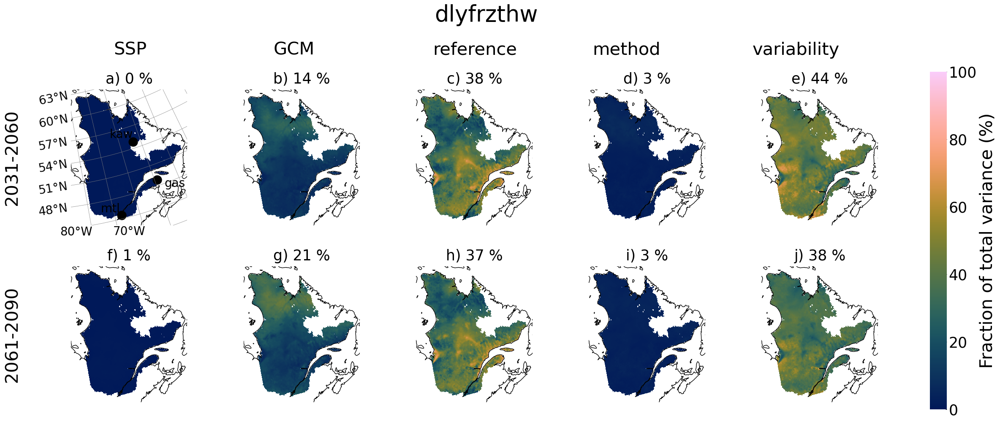

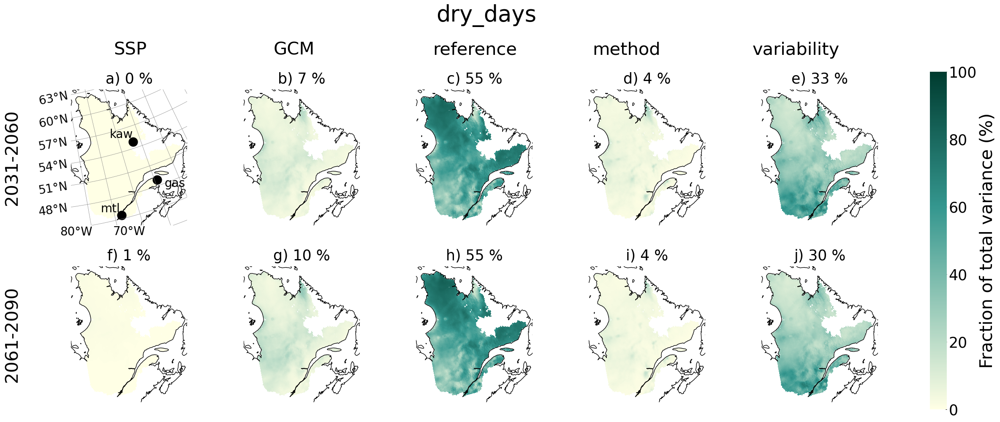

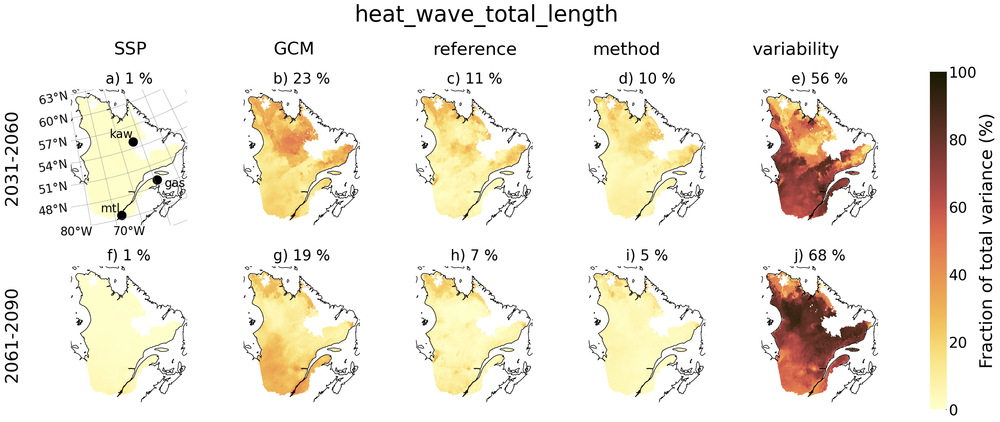

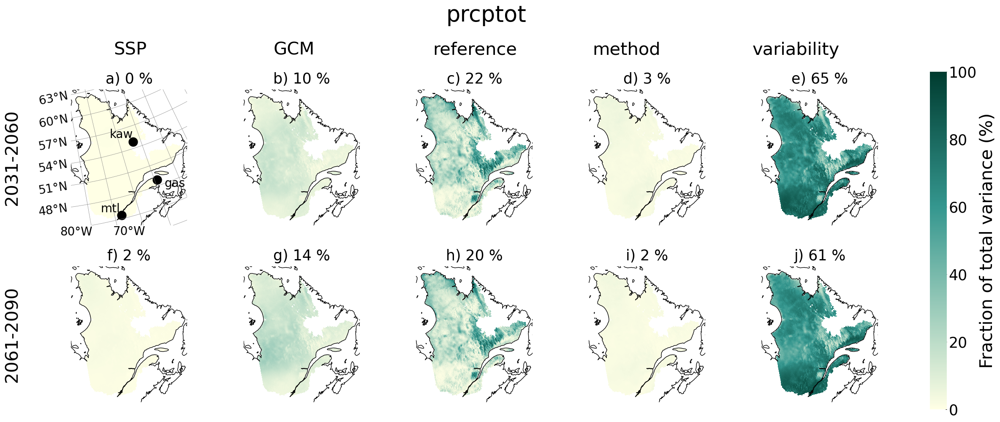

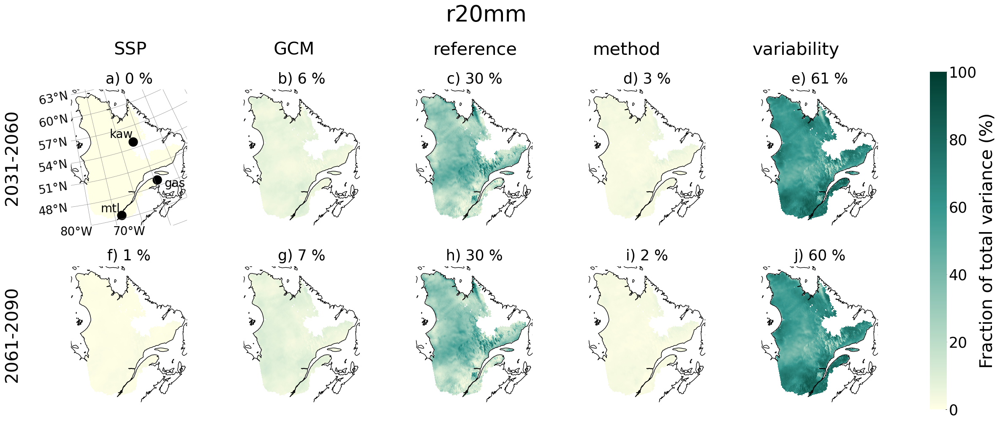

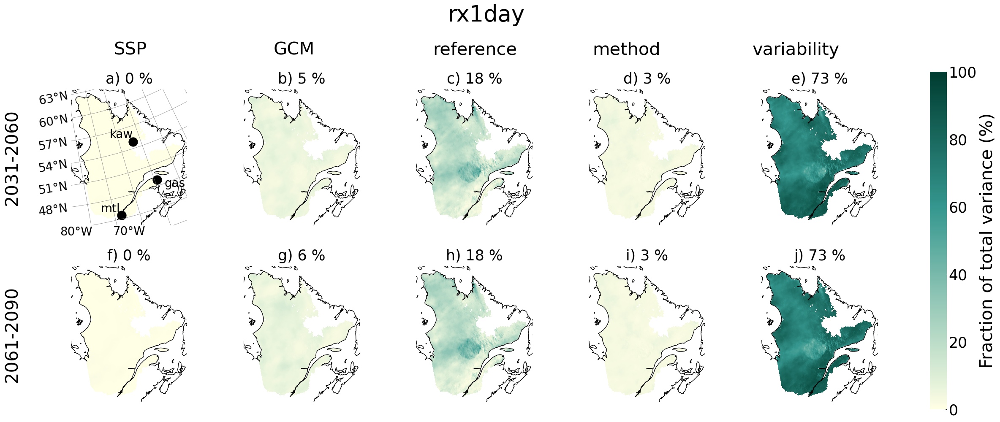

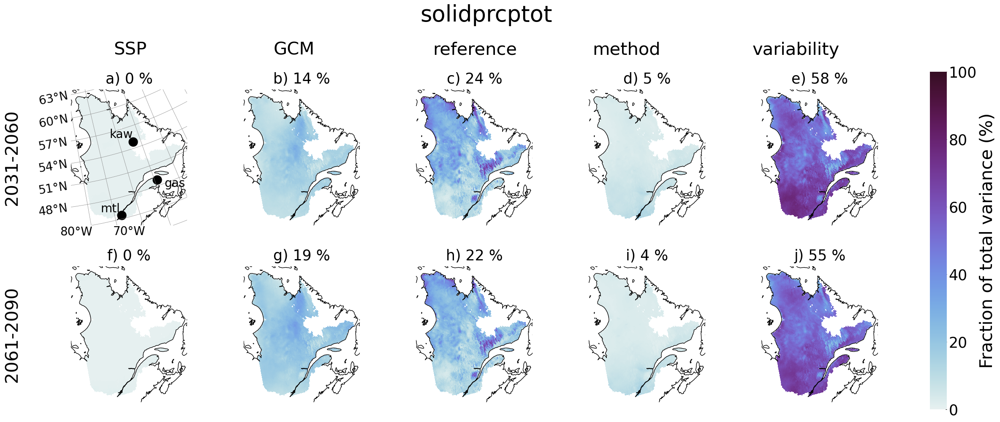

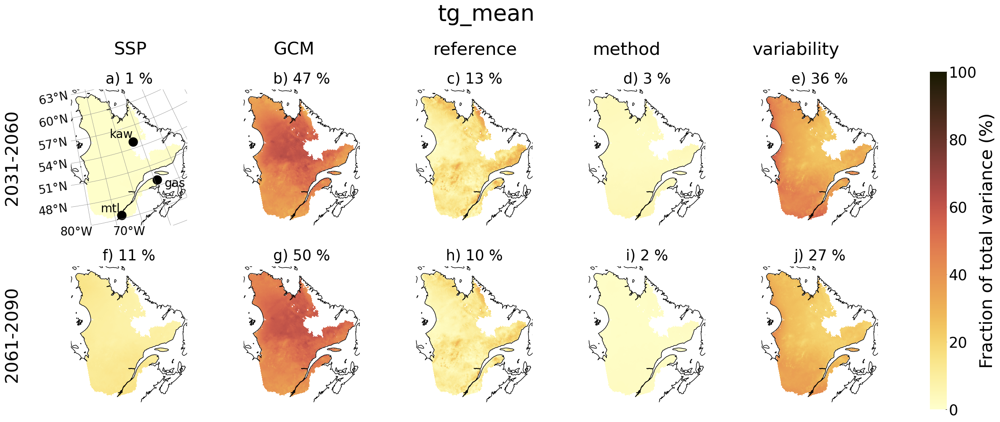

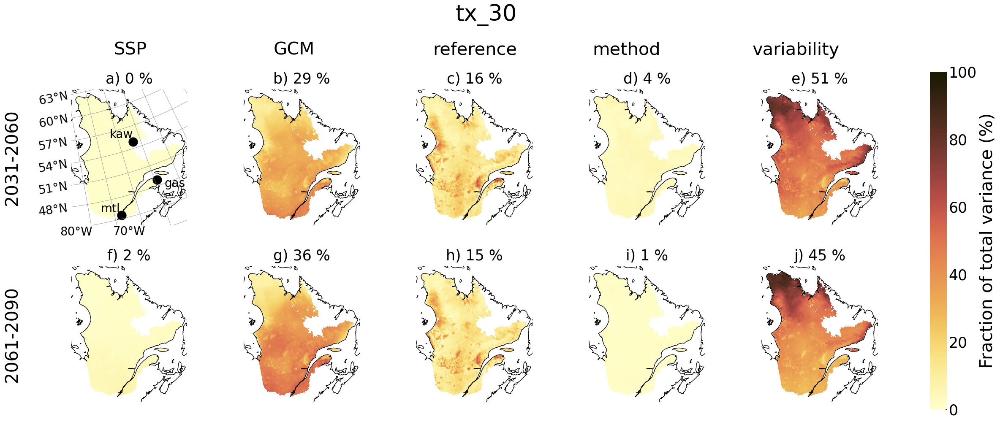

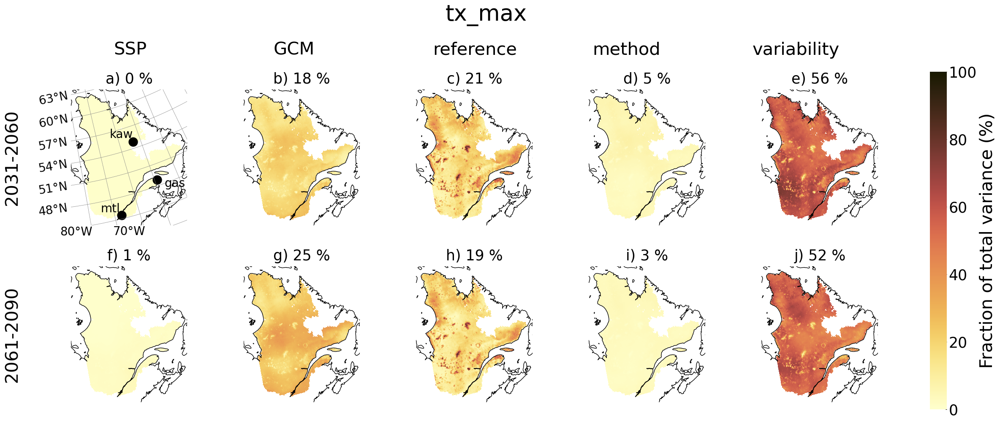

In [7]:
with Client(n_workers=3, threads_per_worker=5, memory_limit="8GB", **daskkws):
    ds=pcat.search(processing_level=f'uncertainties{ens_name}-poly-2015', domain='QC-reg1c').to_dataset(**tdd)
    ds['uncertainty']=[categories[x] for x in ds['uncertainty'].values]
    frac= xc.ensembles.fractional_uncertainty(ds).drop_sel(uncertainty='total')
    frac=xs.climatological_op(frac,op='mean', periods=[['2031','2060'],['2061','2090']],
                             rename_variables=False, horizons_as_dim=True)#.compute()
    frac.lat.attrs['axis']='Y'
    frac.lon.attrs['axis']='X'
    frac.lat.attrs['axis']='Y'
    frac.lon.attrs['axis']='X'
    frac.lat.attrs['long_name'] = "latitude"
    frac.lat.attrs['standard_name'] = "latitude"
    frac.lon.attrs['long_name'] = "longitude"
    frac.lon.attrs['standard_name'] = "longitude"
    frac=xs.spatial.subset(frac, method='shape',shape="region_qc/region_qc.shp").drop_vars('crs')
    for var in frac.data_vars:
        grid=fg.gridmap(frac[var],
                      features={'coastline':{},
                               },
                      cmap=cmaps[var],
                      projection=ccrs.LambertConformal(),
                      plot_kw={'col':'uncertainty','row':'horizon', 'vmin':0, 'vmax':100, #'figsize':(15,10),
                               'size':4, "aspect":1,
                               'cbar_kwargs':{'shrink':0.85},
                              },
                       )
        plt.subplots_adjust(hspace=0.3)
        grid.fig.suptitle(f"{var}",x=0.55, y=1.2, fontsize=38)
        y=1.05
        x=0.13
        dx=0.18
        means=[]
        for j,h in enumerate(frac.horizon.values):
            for i,t in enumerate(['SSP','GCM','reference','method','variability']):
                if j ==0:
                    grid.fig.text(s=t,x=x+ i*dx, y=y, fontsize=30)
            
                spa_mean = xs.spatial_mean(frac[var].sel(uncertainty=t, horizon=h),method='xesmf',
                                           kwargs={'skipna':True},
                                          region= {'name': 'QC-mean','method': 'bbox',
                                                   'lon_bnds': [ -83, -55 ],'lat_bnds': [ 42, 63 ]})
                means.append("{:.0f} %".format(spa_mean.values))
        grid.cbar.set_label('Fraction of total variance (%)', fontsize=30)
        grid.cbar.ax.tick_params(labelsize=25)
        grid.cbar.ax.set_position([1.05, 0, 0.03, 1])

        # move labels to the left
        for i, fax in enumerate(grid.axs.flat):
            for txt in fax.texts:
                if len(txt.get_text()) > 0:
                    txt.set_x(-6.5)
                    txt.set_fontsize(30)
                    txt.set_rotation('vertical')
        for idx, ax in enumerate(grid.axs.flat):
            ax.set_title(f"{string.ascii_lowercase[idx]}) {means[idx]}", fontsize=25)

        grid.axs[0][0].plot(-73.6, 45.5, '.', markersize=30, color='black', transform=ccrs.PlateCarree())
        grid.axs[0][0].text(-77.6, 46.6, 'mtl', fontsize=20, transform=ccrs.PlateCarree())
        grid.axs[0][0].plot(-64.5, 48.8, '.', markersize=30, color='black', transform=ccrs.PlateCarree())
        grid.axs[0][0].text(-63.5, 47.56, 'gas', fontsize=20, transform=ccrs.PlateCarree())
        grid.axs[0][0].plot(-66.8, 54.9, '.', markersize=30, color='black', transform=ccrs.PlateCarree())
        grid.axs[0][0].text(-71.9, 56.3, 'kaw', fontsize=20, transform=ccrs.PlateCarree())
        
        grid.axs[0][0].set_extent([-80,-60, 45, 61], crs=ccrs.PlateCarree())

        gl=grid.axs[0][0].gridlines( draw_labels=True,color='gray',x_inline=False, y_inline=False)
        gl.xlabel_style = {'size': 20, 'rotation':0}
        gl.ylabel_style = {'size': 20}
        gl.top_labels = False
        gl.right_labels = False
        
        grid.fig.savefig(f"{CONFIG['paths']['figures']}maps_{var}.pdf", bbox_inches='tight')



/exec/jlavoie/.conda/partition/lib/python3.11/site-packages/figanos/matplotlib/utils.py:223: UserWarning: Attribute "units" not found.
/exec/jlavoie/.conda/partition/lib/python3.11/site-packages/figanos/matplotlib/utils.py:223: UserWarning: Attribute "long_name" not found.
/exec/jlavoie/.conda/partition/lib/python3.11/site-packages/distributed/client.py:3169: UserWarning: Sending large graph of size 34.07 MiB.
This may cause some slowdown.
Consider scattering data ahead of time and using futures.
/exec/jlavoie/.conda/partition/lib/python3.11/site-packages/figanos/matplotlib/utils.py:223: UserWarning: Attribute "long_name" not found.


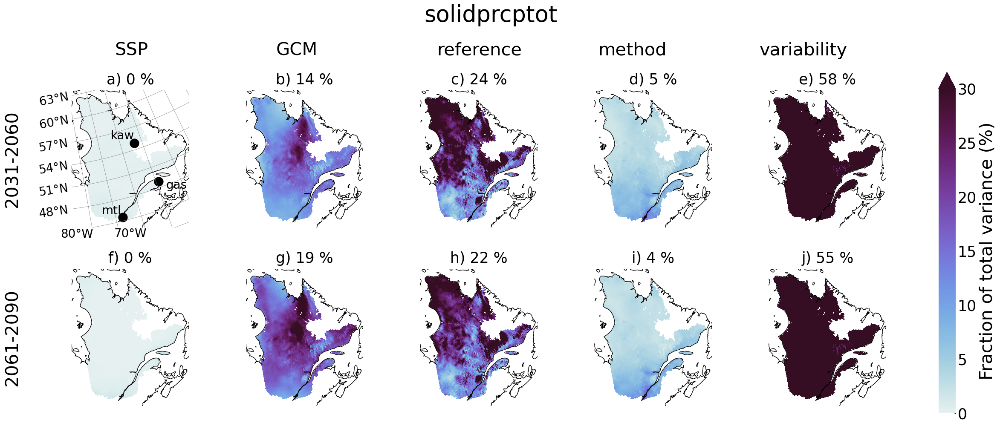

In [8]:
# adjust cbar for solidprcptot
with Client(n_workers=3, threads_per_worker=5, memory_limit="8GB", **daskkws):
    ds=pcat.search(processing_level=f'uncertainties{ens_name}-poly-2015', domain='QC-reg1c').to_dataset(**tdd)
    ds['uncertainty']=[categories[x] for x in ds['uncertainty'].values]
    frac= xc.ensembles.fractional_uncertainty(ds).drop_sel(uncertainty='total')
    frac=xs.climatological_op(frac,op='mean', periods=[['2031','2060'],['2061','2090']],
                             rename_variables=False, horizons_as_dim=True)#.compute()
    frac.lat.attrs['axis']='Y'
    frac.lon.attrs['axis']='X'
    frac.lat.attrs['axis']='Y'
    frac.lon.attrs['axis']='X'
    frac.lat.attrs['long_name'] = "latitude"
    frac.lat.attrs['standard_name'] = "latitude"
    frac.lon.attrs['long_name'] = "longitude"
    frac.lon.attrs['standard_name'] = "longitude"
    frac=xs.spatial.subset(frac, method='shape',shape="region_qc/region_qc.shp").drop_vars('crs')

    for var in ['solidprcptot']:
        grid=fg.gridmap(frac[var],
                      features={'coastline':{},
                               },
                      projection=ccrs.LambertConformal(),
                      cmap=cmaps[var],
                      plot_kw={'col':'uncertainty','row':'horizon', 'vmin':0, 'vmax':30,
                               'size':4, "aspect":1,
                               'cbar_kwargs':{'shrink':0.85},
                              },
                       )
        plt.subplots_adjust(hspace=0.3)
        grid.fig.suptitle(f"{var}",x=0.55, y=1.2, fontsize=38)
        y=1.05
        x=0.13
        dx=0.18
        means=[]
        for j,h in enumerate(frac.horizon.values):
            for i,t in enumerate(['SSP','GCM','reference','method','variability']):
                if j ==0:
                    grid.fig.text(s=t,x=x+ i*dx, y=y, fontsize=30)
            
                spa_mean = xs.spatial_mean(frac[var].sel(uncertainty=t, horizon=h),method='xesmf',
                                           kwargs={'skipna':True},
                                          region= {'name': 'QC-mean','method': 'bbox',
                                                   'lon_bnds': [ -83, -55 ],'lat_bnds': [ 42, 63 ]})
                means.append("{:.0f} %".format(spa_mean.values))
        grid.cbar.set_label('Fraction of total variance (%)', fontsize=30)
        grid.cbar.ax.tick_params(labelsize=25)
        grid.cbar.ax.set_position([1.05, 0, 0.03, 1])


        # move labels to the left
        for i, fax in enumerate(grid.axs.flat):
            for txt in fax.texts:
                if len(txt.get_text()) > 0:
                    txt.set_x(-6.5)
                    txt.set_fontsize(30)
                    txt.set_rotation('vertical')
        for idx, ax in enumerate(grid.axs.flat):
            ax.set_title(f"{string.ascii_lowercase[idx]}) {means[idx]}", fontsize=25)

        grid.axs[0][0].plot(-73.6, 45.5, '.', markersize=30, color='black', transform=ccrs.PlateCarree())
        grid.axs[0][0].text(-77.6, 46.6, 'mtl', fontsize=20, transform=ccrs.PlateCarree())
        grid.axs[0][0].plot(-64.5, 48.8, '.', markersize=30, color='black', transform=ccrs.PlateCarree())
        grid.axs[0][0].text(-63.5, 47.56, 'gas', fontsize=20, transform=ccrs.PlateCarree())
        grid.axs[0][0].plot(-66.8, 54.9, '.', markersize=30, color='black', transform=ccrs.PlateCarree())
        grid.axs[0][0].text(-71.9, 56.3, 'kaw', fontsize=20, transform=ccrs.PlateCarree())
        
        grid.axs[0][0].set_extent([-80,-60, 45, 61], crs=ccrs.PlateCarree())

        gl=grid.axs[0][0].gridlines( draw_labels=True,color='gray',x_inline=False, y_inline=False)
        gl.xlabel_style = {'size': 20, 'rotation':0}
        gl.ylabel_style = {'size': 20}
        gl.top_labels = False
        gl.right_labels = False
        grid.fig.savefig(f"{CONFIG['paths']['figures']}maps_{var}_30.pdf", bbox_inches='tight')


# case studies

/exec/jlavoie/.conda/partition/lib/python3.11/site-packages/seaborn/_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
/exec/jlavoie/.conda/partition/lib/python3.11/site-packages/seaborn/_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
/exec/jlavoie/.conda/partition/lib/python3.11/site-packages/seaborn/_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
/exec/jlavoie/.conda/partition/lib/python3.11/site-packages/seaborn/_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a l

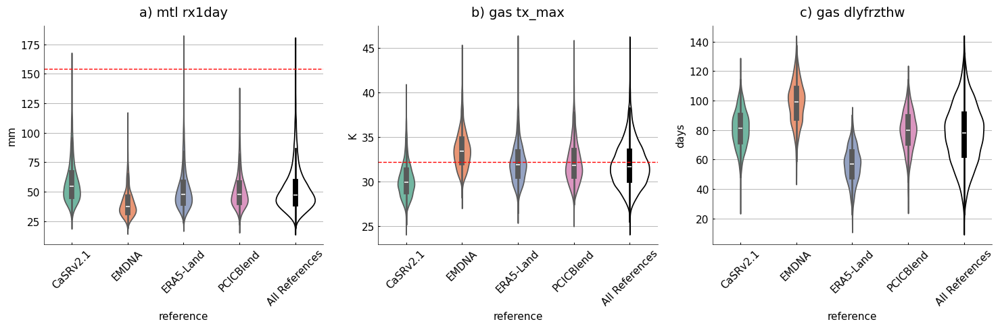

In [9]:
fig, axs = plt.subplots(1,3, figsize=(15,5), sharex=True, sharey=False)


for i, var in enumerate(['rx1day', 'tx_max', 'dlyfrzthw']):
    d='mtl' if var=='rx1day' else 'gas'
    ds=pcat.search(processing_level=f'partition-ensemble{ens_name}', 
                   domain=d).to_dataset(**tdd)
    ds['tx_max']=xc.core.units.convert_units_to(ds['tx_max'], 'degC')
    ds['tg_mean']=xc.core.units.convert_units_to(ds['tg_mean'], 'degC')
    ds= ds.sel(time=slice('2061','2090'))

    df = ds[var].to_dataframe(name=var).reset_index()


    # Plotting the violinplot
    sns.violinplot(x='reference', y=var, data=df,width=0.3, ax=axs[i],
                   order=['CaSRv2.1','EMDNA','ERA5-Land','PCICBlend'],
                   palette="Set2",
                   hue='reference',legend=False);


    df_combined = df.copy()
    df_combined['reference'] = 'All References'

    # Add the violin plot for all references on the x-axis
    sns.violinplot(
        x='reference', y=var, data=df_combined, width=0.7, ax=axs[i],
        order=['All References', 'CaSRv2.1', 'EMDNA', 'ERA5-Land', 'PCICBlend'],
        color='white', edgecolor='black', # You can adjust the color for the 'All References' violin
        legend=False
    )

    axs[i].set_title(f"{string.ascii_lowercase[i]}) {d} {var}")
    axs[i].tick_params(axis='x', rotation=45)
    axs[i].set_ylabel(units[var])

axs[1].axhline(32.2, linestyle='--', color='red',lw=1)        
axs[0].axhline(154, linestyle='--', color='red',lw=1)
fig.tight_layout()

fig.savefig(f"{CONFIG['paths']['figures']}ref_dist.pdf", bbox_inches='tight')


# larger ensemble gridpoint and maps (SI)


--> The keys in the returned dictionary of datasets are constructed as follows:
	'id.domain.processing_level.xrfreq'


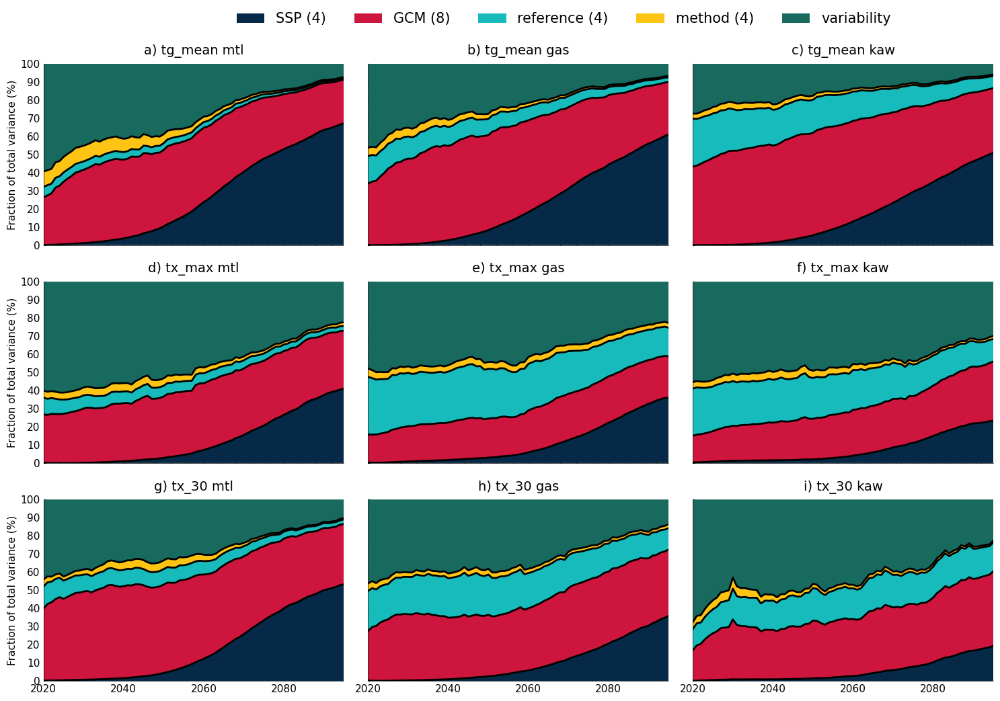

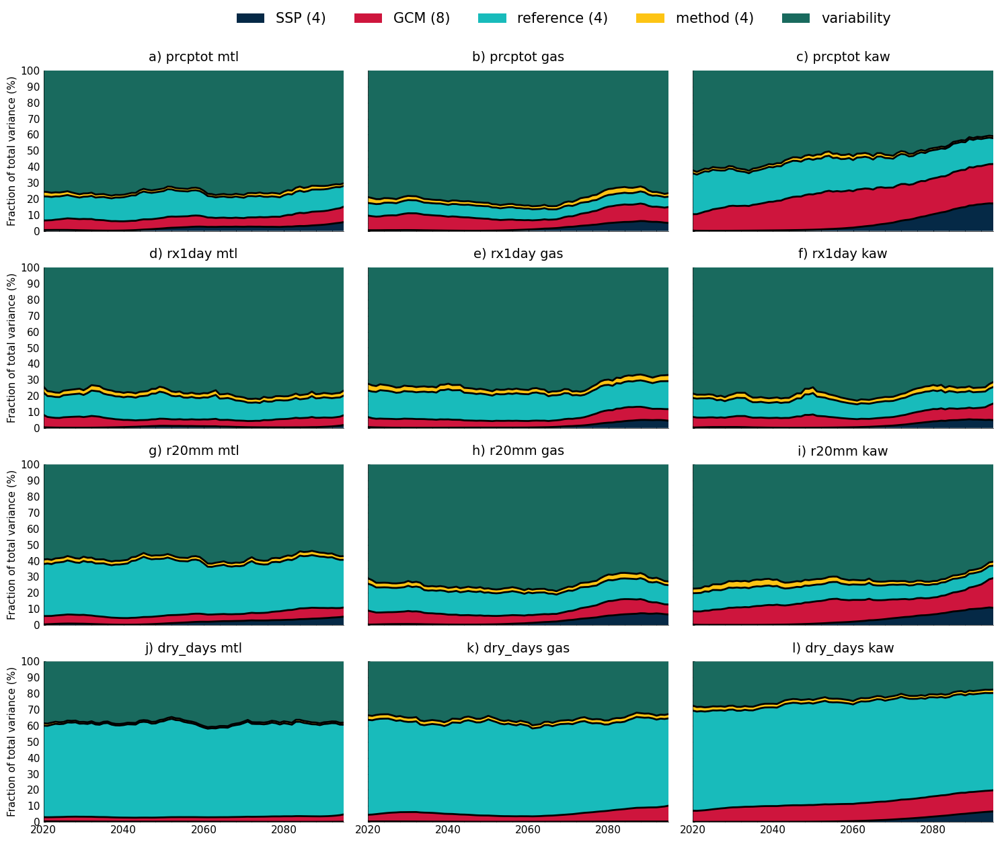

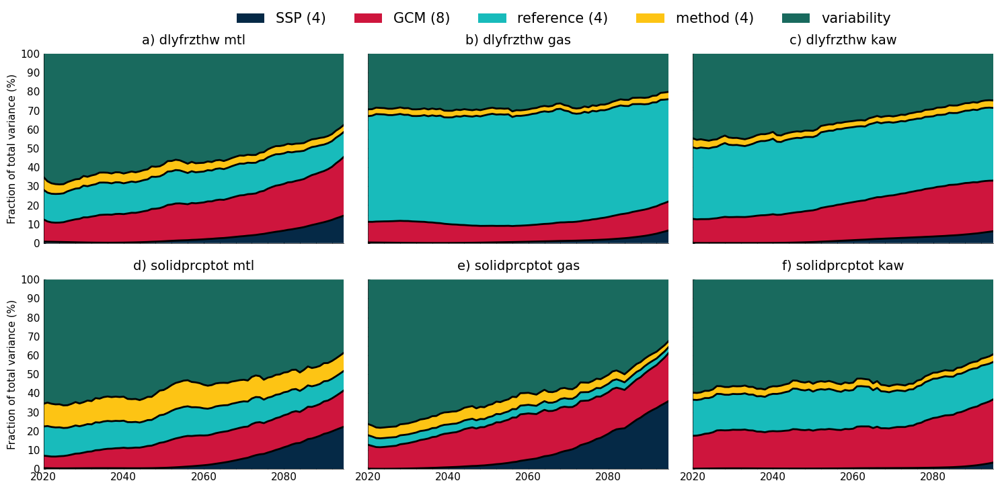

In [10]:
#8444
matplotlib.rcParams['axes.prop_cycle'] = matplotlib.cycler(color=['#052946', '#ce153d', '#18bbbb', '#fdc414','#196a5e', '#6850af',  '#7a5315']) 

d_tmp=pcat.search(processing_level=f'uncertainties8444-poly-2015', domain=['mtl','gas','kaw'] ).to_dataset_dict(**tdd)


#fix names
for k,v in d_tmp.items():
        v['uncertainty']=[categories[x] for x in v['uncertainty'].values]
        for c in categories:
            for var in v.data_vars:
                if c in v[var].attrs:
                    v[var].attrs[categories[c]]=v[var].attrs[c]

# put in right order
d={'CMIP6_ScenarioMIP_mtl.mtl.uncertainties8444-poly-2015.YS-JAN':d_tmp['CMIP6_ScenarioMIP_mtl.mtl.uncertainties8444-poly-2015.YS-JAN'],
  'CMIP6_ScenarioMIP_gas.gas.uncertainties8444-poly-2015.YS-JAN':d_tmp['CMIP6_ScenarioMIP_gas.gas.uncertainties8444-poly-2015.YS-JAN'],
    'CMIP6_ScenarioMIP_kaw.kaw.uncertainties8444-poly-2015.YS-JAN':d_tmp['CMIP6_ScenarioMIP_kaw.kaw.uncertainties8444-poly-2015.YS-JAN'],
}



fig, axs= plt.subplots(3,3, figsize=(15,10), sharex=True, sharey=True)
for i, (id, ds) in enumerate(d.items()):
    domain=ds.attrs['cat:domain']
    for j, var in enumerate(['tg_mean','tx_max','tx_30']):
        frac= xc.ensembles.fractional_uncertainty(ds[var]).sel(time=slice('2015','2100'))
        fg.partition(frac,show_num=True,ax=axs[j,i])
        axs[j,i].set_title(f"{string.ascii_lowercase[(3*j)+i]}) {var} {domain}")
        
        axs[j,i].get_legend().remove()
        axs[j,1].set_ylabel('')
        axs[j,2].set_ylabel('')
    
handles, labels = axs[j,i].get_legend_handles_labels()
by_label = dict(zip(labels, handles)).copy()
fig.legend(by_label.values(), by_label.keys(),bbox_to_anchor=(0.90,1.05), ncol=5, fontsize=15)
fig.tight_layout()
fig.savefig(f"{CONFIG['paths']['figures']}tas_unc_8444.pdf", bbox_inches='tight')



fig, axs= plt.subplots(4,3, figsize=(15,12), sharex=True, sharey=True)
for i, (id, ds) in enumerate(d.items()):
    domain=ds.attrs['cat:domain']
    for j, var in enumerate(['prcptot','rx1day', 'r20mm','dry_days']):
        frac= xc.ensembles.fractional_uncertainty(ds[var]).sel(time=slice('2015','2100'))
        fg.partition(frac,show_num=True,ax=axs[j,i])
        axs[j,i].set_title(f"{string.ascii_lowercase[(3*j)+i]}) {var} {domain}")
        axs[j,i].get_legend().remove()
        axs[j,1].set_ylabel('')
        axs[j,2].set_ylabel('')
    
handles, labels = axs[j,i].get_legend_handles_labels()
by_label = dict(zip(labels, handles)).copy()
fig.legend(by_label.values(), by_label.keys(),bbox_to_anchor=(0.90,1.05), ncol=5, fontsize=15)
fig.tight_layout()
fig.savefig(f"{CONFIG['paths']['figures']}pr_unc_8444.pdf", bbox_inches='tight')


fig, axs= plt.subplots(2,3, figsize=(15,7), sharex=True, sharey=True)
for i, (id, ds) in enumerate(d.items()):
    domain=ds.attrs['cat:domain']
    for j, var in enumerate(['dlyfrzthw','solidprcptot']): #
        frac= xc.ensembles.fractional_uncertainty(ds[var]).sel(time=slice('2015','2100'))
        fg.partition(frac,show_num=True,ax=axs[j,i])
        axs[j,i].set_title(f"{string.ascii_lowercase[(3*j)+i]}) {var} {domain}")
        axs[j,i].get_legend().remove()
        axs[j,1].set_ylabel('')
        axs[j,2].set_ylabel('')
        
handles, labels = axs[j,i].get_legend_handles_labels()
by_label = dict(zip(labels, handles)).copy()
fig.legend(by_label.values(), by_label.keys(),bbox_to_anchor=(0.90,1.05), ncol=5, fontsize=15)
fig.tight_layout()
fig.savefig(f"{CONFIG['paths']['figures']}multi_unc_8444.pdf", bbox_inches='tight')

/exec/jlavoie/.conda/partition/lib/python3.11/site-packages/figanos/matplotlib/utils.py:223: UserWarning: Attribute "units" not found.
/exec/jlavoie/.conda/partition/lib/python3.11/site-packages/figanos/matplotlib/utils.py:223: UserWarning: Attribute "long_name" not found.
/exec/jlavoie/.conda/partition/lib/python3.11/site-packages/distributed/client.py:3169: UserWarning: Sending large graph of size 34.07 MiB.
This may cause some slowdown.
Consider scattering data ahead of time and using futures.
/exec/jlavoie/.conda/partition/lib/python3.11/site-packages/figanos/matplotlib/utils.py:223: UserWarning: Attribute "long_name" not found.
/exec/jlavoie/.conda/partition/lib/python3.11/site-packages/figanos/matplotlib/utils.py:223: UserWarning: Attribute "units" not found.
/exec/jlavoie/.conda/partition/lib/python3.11/site-packages/figanos/matplotlib/utils.py:223: UserWarning: Attribute "long_name" not found.
/exec/jlavoie/.conda/partition/lib/python3.11/site-packages/distributed/client.py:316

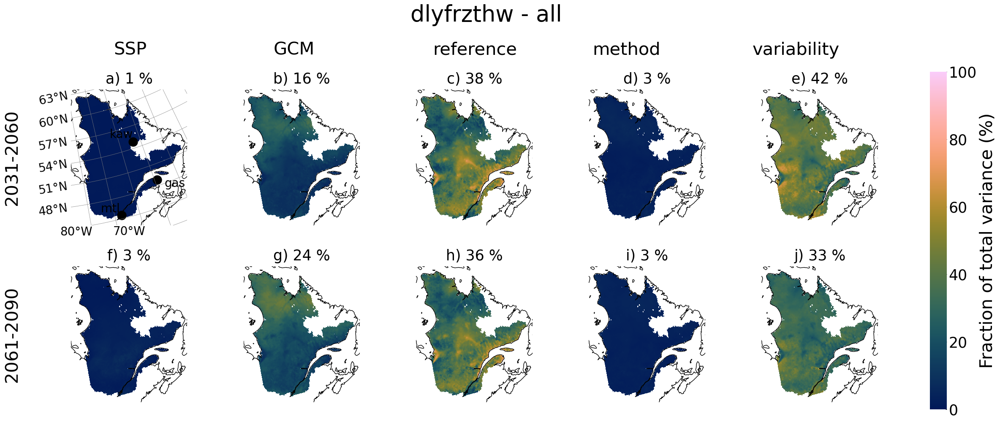

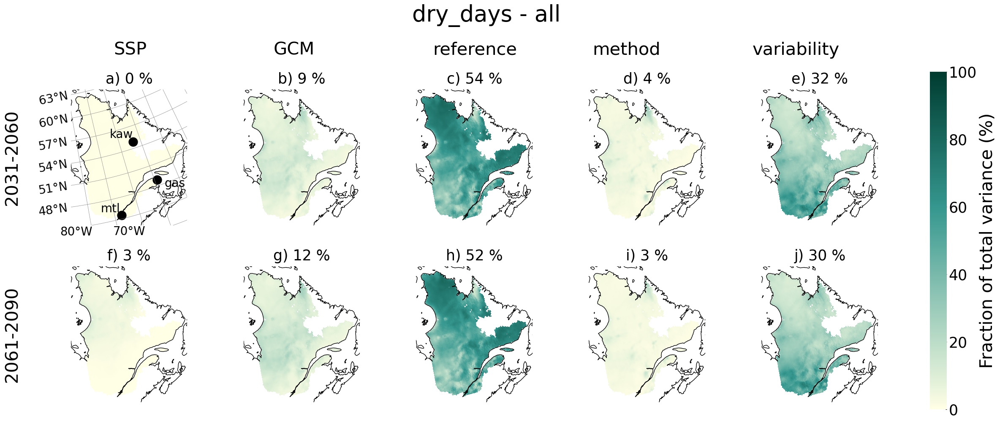

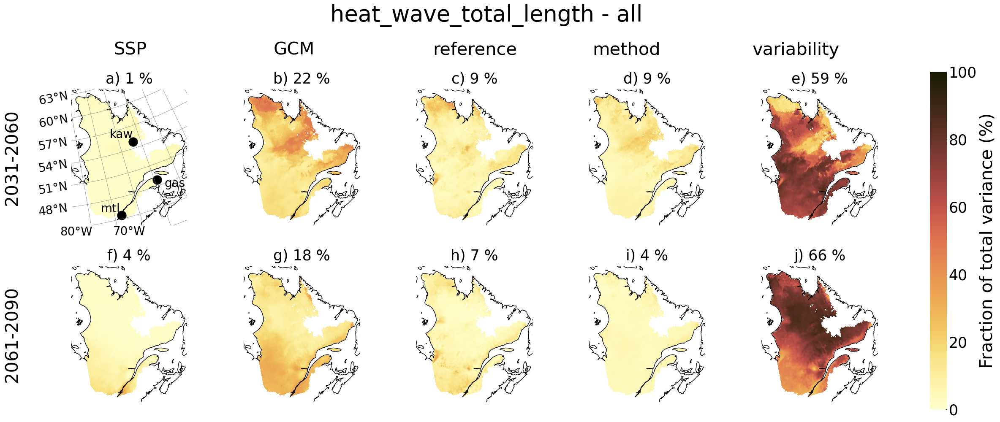

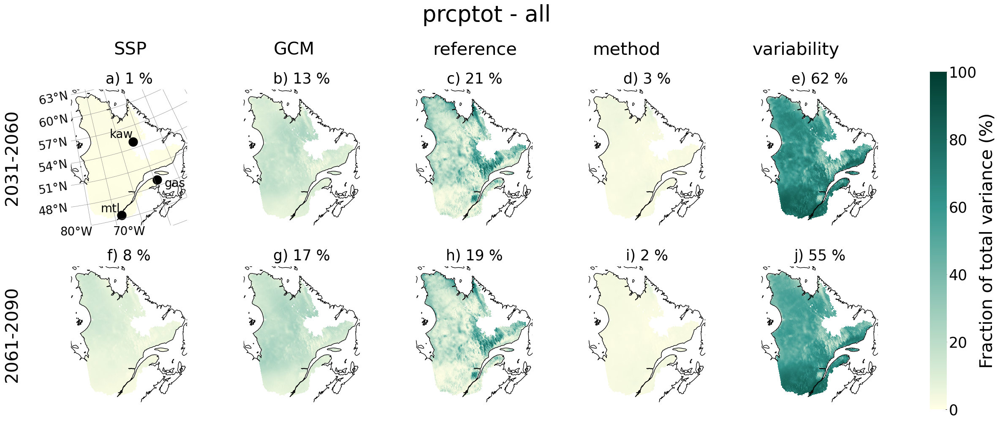

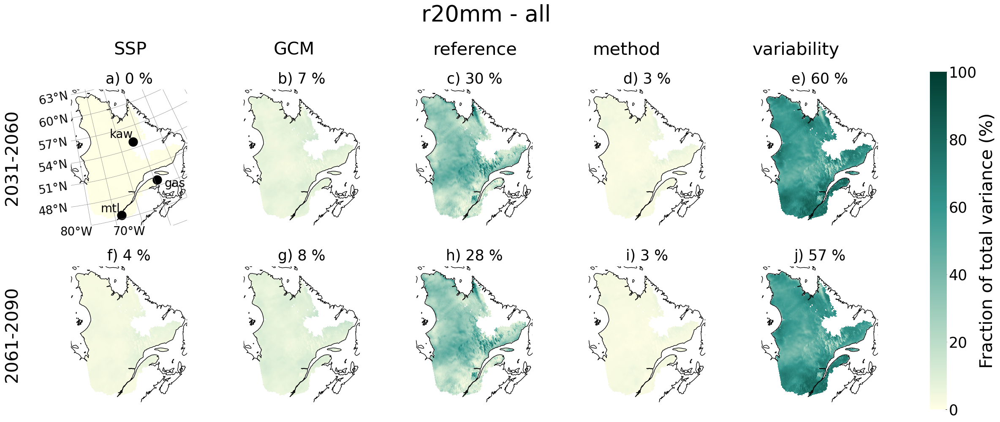

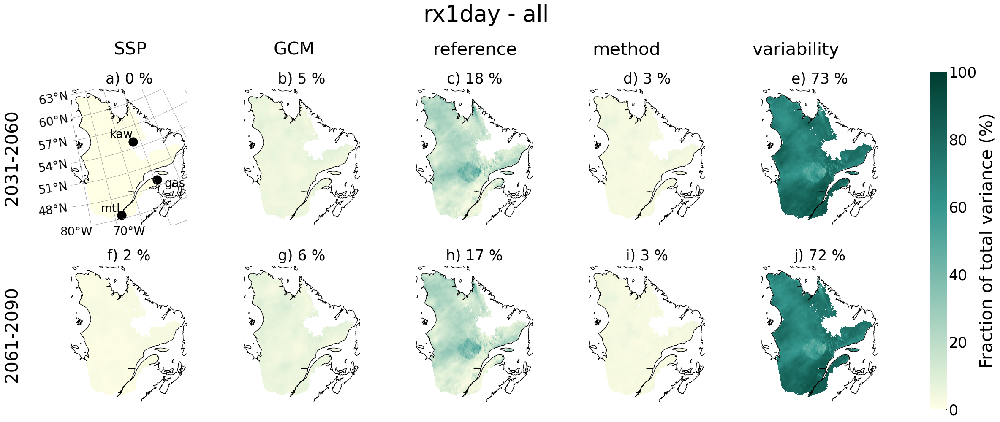

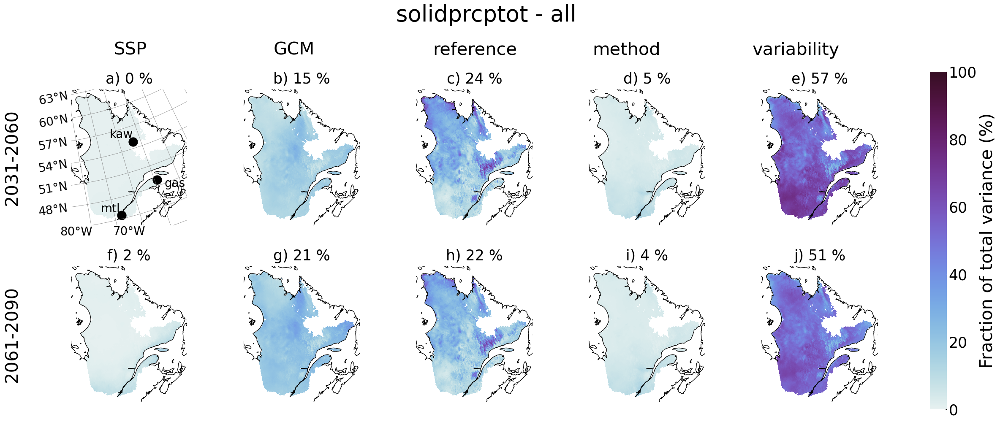

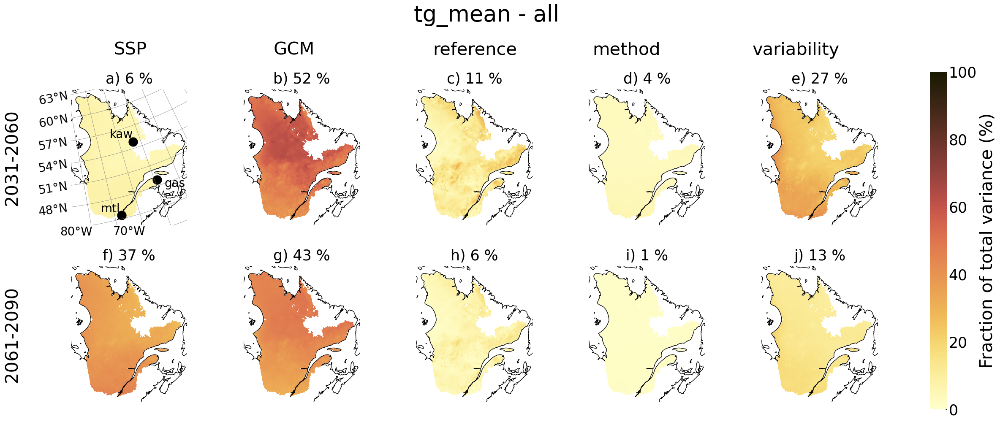

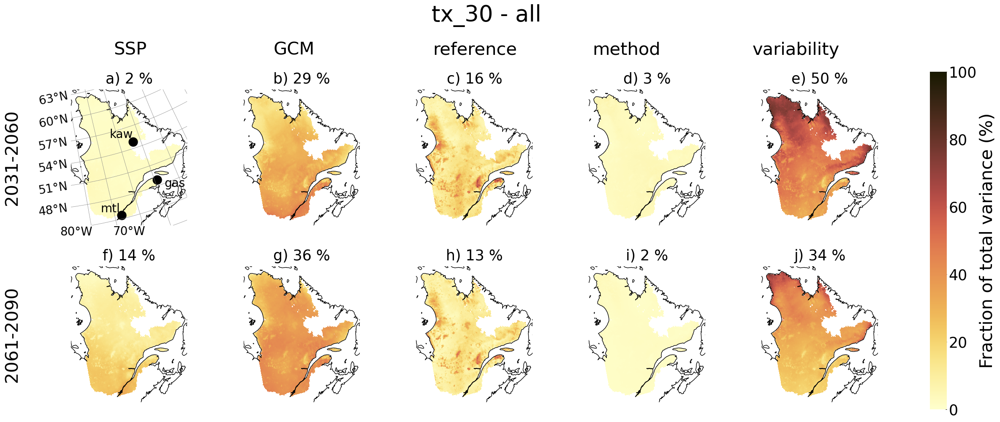

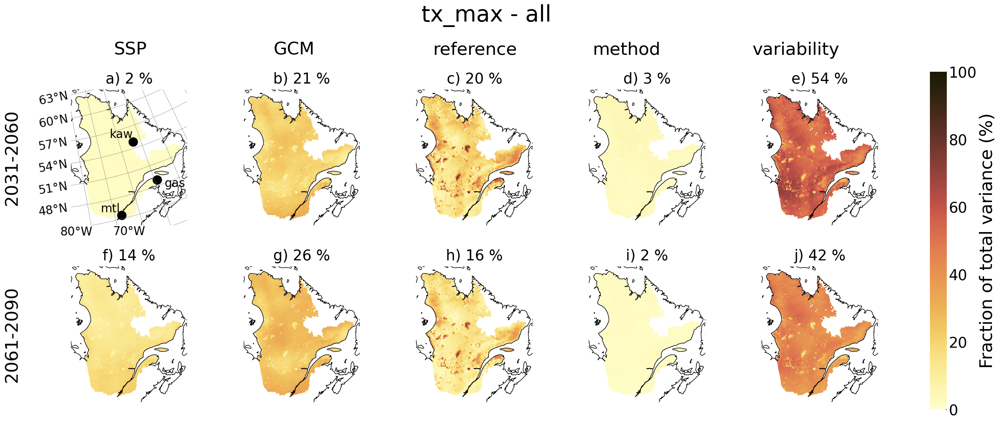

In [11]:

with Client(n_workers=9, threads_per_worker=5, memory_limit="8GB", **daskkws):
    ds=pcat.search(processing_level=f'uncertainties8444-poly-2015', domain='QC-reg1c').to_dataset(**tdd)
    ds['uncertainty']=[categories[x] for x in ds['uncertainty'].values]

    frac= xc.ensembles.fractional_uncertainty(ds).drop_sel(uncertainty='total')
    frac=xs.climatological_op(frac,op='mean', periods=[['2031','2060'],['2061','2090']],
                             rename_variables=False, horizons_as_dim=True)#.compute()
    frac.lat.attrs['axis']='Y'
    frac.lon.attrs['axis']='X'
    frac.lat.attrs['axis']='Y'
    frac.lon.attrs['axis']='X'
    frac.lat.attrs['long_name'] = "latitude"
    frac.lat.attrs['standard_name'] = "latitude"
    frac.lon.attrs['long_name'] = "longitude"
    frac.lon.attrs['standard_name'] = "longitude"
    frac=xs.spatial.subset(frac, method='shape',shape="region_qc/region_qc.shp").drop_vars('crs')

    for var in frac.data_vars:
        grid=fg.gridmap(frac[var],
                      features={'coastline':{},
                               },
                      projection=ccrs.LambertConformal(),
                      cmap=cmaps[var],
                      plot_kw={'col':'uncertainty','row':'horizon', 'vmin':0, 'vmax':100, 
                               'size':4, "aspect":1,
                               'cbar_kwargs':{'shrink':0.85},
                              },
                       )
        plt.subplots_adjust(hspace=0.3)
        grid.fig.suptitle(f"{var} - all",x=0.55, y=1.2, fontsize=38)
        y =1.05
        x=0.13
        dx=0.18

        means=[]
        for j,h in enumerate(frac.horizon.values):
            for i,t in enumerate(['SSP','GCM','reference','method','variability']):
                if j ==0:
                    grid.fig.text(s=t,x=x+ i*dx, y=y, fontsize=30)
            
                spa_mean = xs.spatial_mean(frac[var].sel(uncertainty=t, horizon=h),method='xesmf',
                                           kwargs={'skipna':True},
                                          region= {'name': 'QC-mean','method': 'bbox',
                                                   'lon_bnds': [ -83, -55 ],'lat_bnds': [ 42, 63 ]})
                means.append("{:.0f} %".format(spa_mean.values))
        grid.cbar.set_label('Fraction of total variance (%)', fontsize=30)
        grid.cbar.ax.tick_params(labelsize=25)
        grid.cbar.ax.set_position([1.05, 0, 0.03, 1])

        # move labels to the left
        for i, fax in enumerate(grid.axs.flat):
            for txt in fax.texts:
                if len(txt.get_text()) > 0:
                    txt.set_x(-6.5)
                    txt.set_fontsize(30)
                    txt.set_rotation('vertical')
        for idx, ax in enumerate(grid.axs.flat):
            ax.set_title(f"{string.ascii_lowercase[idx]}) {means[idx]}", fontsize=25)
        grid.axs[0][0].plot(-73.6, 45.5, '.', markersize=30, color='black', transform=ccrs.PlateCarree())
        grid.axs[0][0].text(-77.6, 46.6, 'mtl', fontsize=20, transform=ccrs.PlateCarree())
        grid.axs[0][0].plot(-64.5, 48.8, '.', markersize=30, color='black', transform=ccrs.PlateCarree())
        grid.axs[0][0].text(-63.5, 47.56, 'gas', fontsize=20, transform=ccrs.PlateCarree())
        grid.axs[0][0].plot(-66.8, 54.9, '.', markersize=30, color='black', transform=ccrs.PlateCarree())
        grid.axs[0][0].text(-71.9, 56.3, 'kaw', fontsize=20, transform=ccrs.PlateCarree())
        
        grid.axs[0][0].set_extent([-80,-60, 45, 61], crs=ccrs.PlateCarree())

        gl=grid.axs[0][0].gridlines( draw_labels=True,color='gray',x_inline=False, y_inline=False)
        gl.xlabel_style = {'size': 20, 'rotation':0}
        gl.ylabel_style = {'size': 20}
        gl.top_labels = False
        gl.right_labels = False
        
        grid.fig.savefig(f"{CONFIG['paths']['figures']}maps_{var}_8444.pdf", bbox_inches='tight')



# reference timeseries (SI)


--> The keys in the returned dictionary of datasets are constructed as follows:
	'id.domain.processing_level.xrfreq'


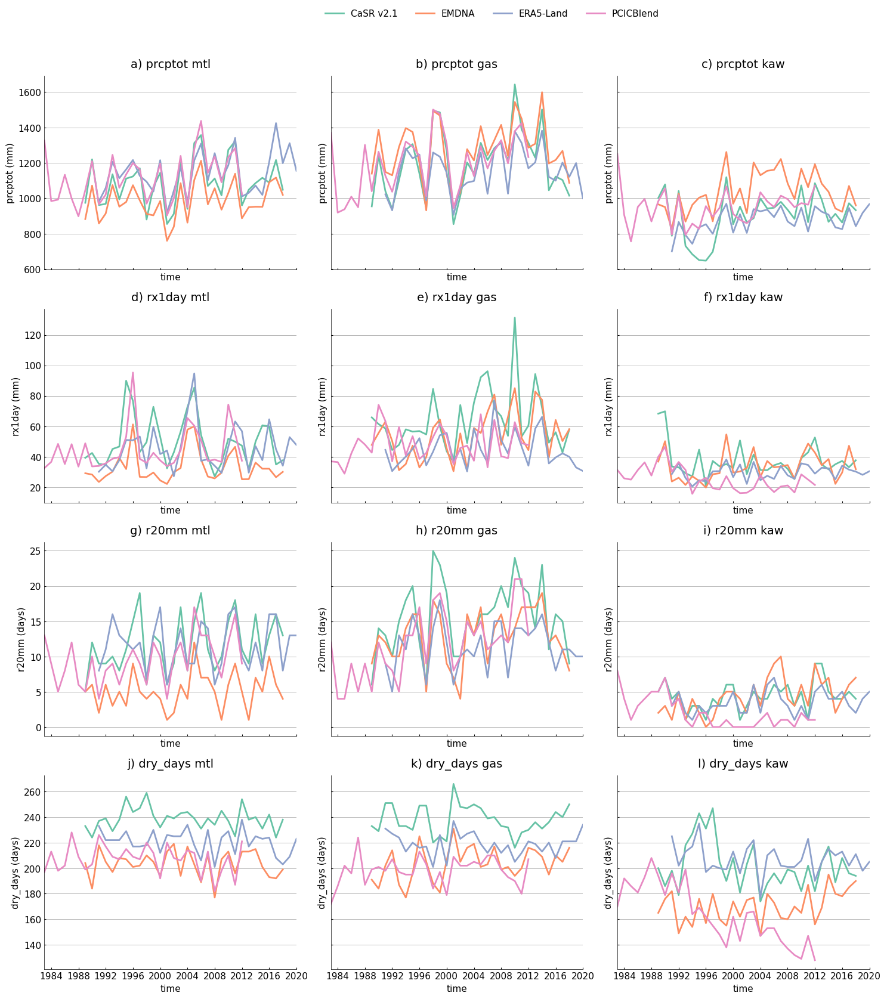

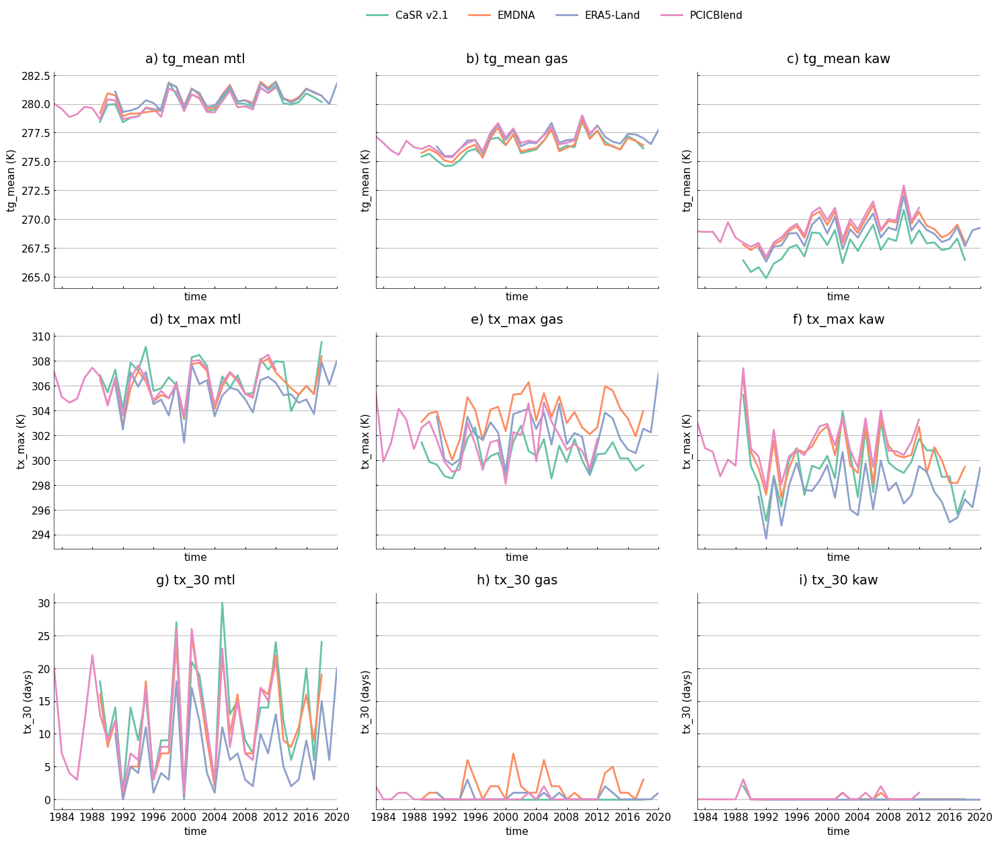

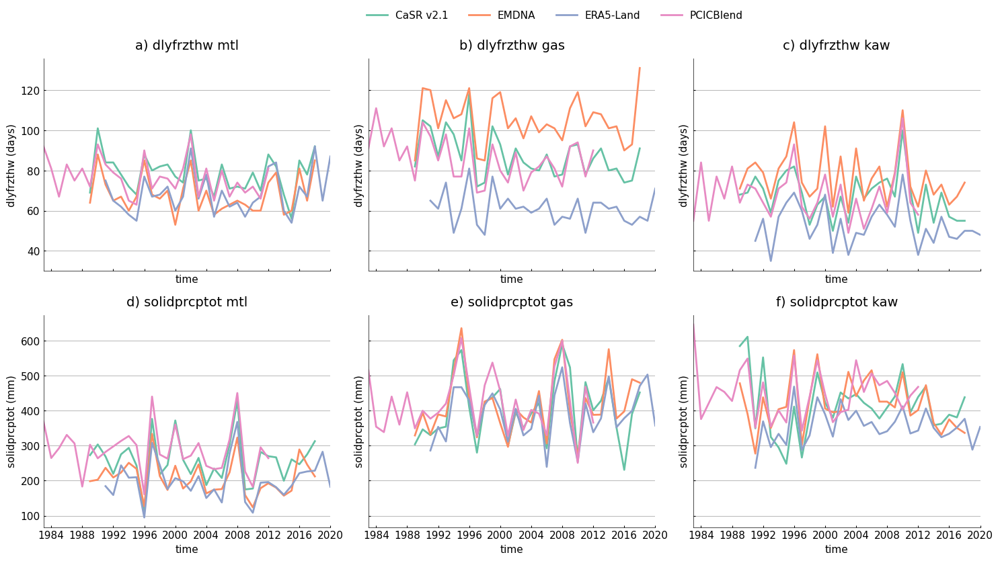

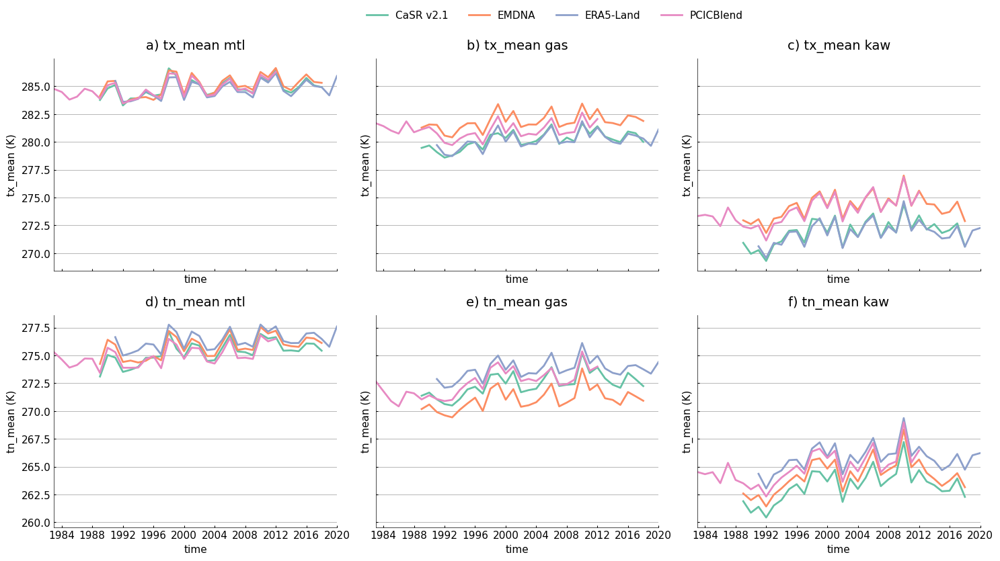

In [12]:

subcat = pcat.search(processing_level='indicators', bias_adjust_project='reference',
                             domain='QC',).to_dataset_dict(**CONFIG['tdd'])

all_var=[['prcptot', 'rx1day','r20mm','dry_days'], ['tg_mean', 'tx_max','tx_30'], ['dlyfrzthw', 'solidprcptot'],
         ['tx_mean','tn_mean']]
num_lines=4
cmap = sns.color_palette("Set2", as_cmap=True)

ls=['-','-.',':','--']
for variables in all_var:
    fs= (15,len(variables)*4)
    fig,axs= plt.subplots(len(variables),3,figsize=fs, sharex=True, sharey='row')

    for j,var in enumerate(variables):

        for n,ids in enumerate(['reference_GovCan_RDRS_QC.QC.indicators.YS-JAN',
                               'reference_USask_EMDNA_OI_QC.QC.indicators.YS-JAN',
                                'reference_ECMWF_ERA5-Land_QC.QC.indicators.YS-JAN',
                                'reference_PCIC_PCICBlend_QC.QC.indicators.YS-JAN'
                               ]):
            ds=subcat[ids]
            color=cmap(n)
            for i,(point, point_dict) in enumerate(CONFIG['gridpoints'].items()):
                da=xs.spatial.subset(ds[var],**point_dict)


                da.plot(label=ids.split("_")[2], ax=axs[j,i], color=color, linewidth=2)
                axs[j,i].set_title(f"{string.ascii_lowercase[(3*j)+i]}) {var} {point}")
                axs[j,i].set_ylabel(f"{var} ({da.attrs['units']})")
        handles, labels =axs[j,i].get_legend_handles_labels()
        labels=[l.replace('RDRS', 'CaSR v2.1') for l in labels]
        fig.legend(handles, labels,bbox_to_anchor=(0.75,1.05),ncol=4)
        fig.tight_layout()
        
    fig.savefig(f"{CONFIG['paths']['figures']}ref_ts_{variables[0]}.pdf", bbox_inches='tight')

In [13]:
# max diff btm ref
var='tx_max'
ds_c=pcat.search(processing_level='indicators', bias_adjust_project='reference', variable=var,source='RDRS',
                             domain='QC',).to_dataset(**CONFIG['tdd'])
da_c=xs.spatial.subset(ds_c[var],**CONFIG['gridpoints']['gas'])


ds_e=pcat.search(processing_level='indicators', bias_adjust_project='reference', variable=var,source='EMDNA',
                             domain='QC',).to_dataset(**CONFIG['tdd'])
da_e=xs.spatial.subset(ds_e[var],**CONFIG['gridpoints']['gas'])

diff=da_c-da_e

print(diff.mean(dim='time').values)

-3.3002014


In [14]:
# max diff btm ref
var='dlyfrzthw'
ds_c=pcat.search(processing_level='indicators', bias_adjust_project='reference', variable=var,source='ERA5-Land',
                             domain='QC',).to_dataset(**CONFIG['tdd'])
da_c=xs.spatial.subset(ds_c[var],**CONFIG['gridpoints']['gas'])


ds_e=pcat.search(processing_level='indicators', bias_adjust_project='reference', variable=var,source='EMDNA',
                             domain='QC',).to_dataset(**CONFIG['tdd'])
da_e=xs.spatial.subset(ds_e[var],**CONFIG['gridpoints']['gas'])

diff=da_c-da_e

print(diff.mean(dim='time').values)

-44.607142857142854


# reference maps of std (SI)

/exec/jlavoie/.conda/partition/lib/python3.11/site-packages/figanos/matplotlib/utils.py:998: UserWarning: No spaces, points or colons to break line at.
/exec/jlavoie/.conda/partition/lib/python3.11/site-packages/dask/array/numpy_compat.py:53: RuntimeWarning: invalid value encountered in divide
/exec/jlavoie/.conda/partition/lib/python3.11/site-packages/dask/array/numpy_compat.py:53: RuntimeWarning: invalid value encountered in divide
/exec/jlavoie/.conda/partition/lib/python3.11/site-packages/dask/array/numpy_compat.py:53: RuntimeWarning: invalid value encountered in divide
/exec/jlavoie/.conda/partition/lib/python3.11/site-packages/dask/array/numpy_compat.py:53: RuntimeWarning: invalid value encountered in divide
/exec/jlavoie/.conda/partition/lib/python3.11/site-packages/dask/array/numpy_compat.py:53: RuntimeWarning: invalid value encountered in divide
/exec/jlavoie/.conda/partition/lib/python3.11/site-packages/dask/array/numpy_compat.py:53: RuntimeWarning: invalid value encountered 

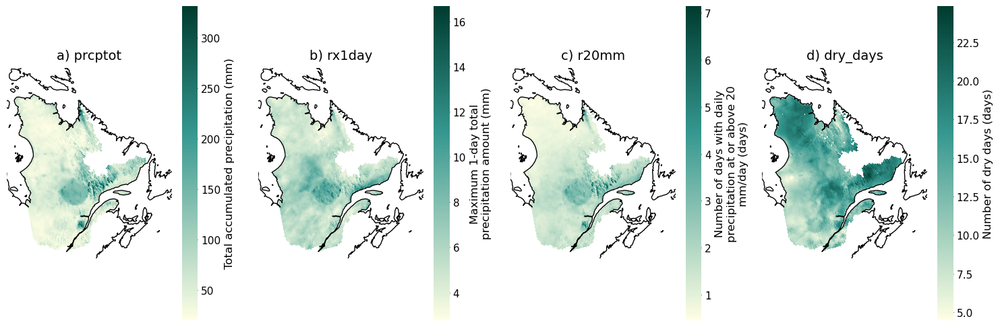

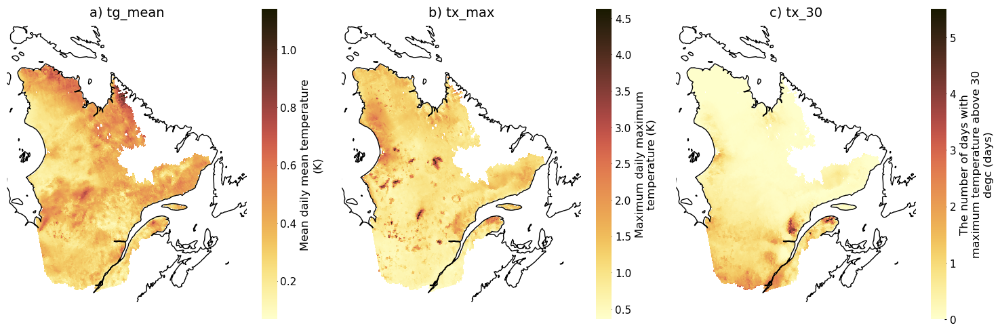

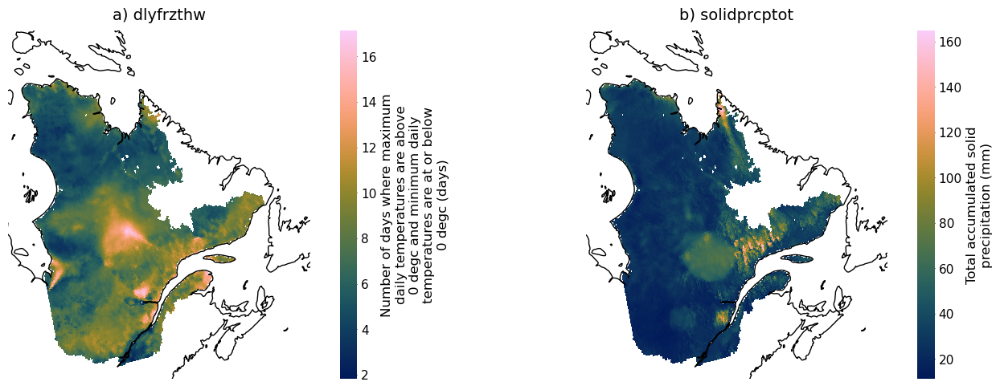

In [15]:
with plt.rc_context({'axes.labelsize':12}):

    refs=[]
    for s in ['RDRS', 'EMDNA','ERA5-Land','PCICBlend']:
        cur=pcat.search(bias_adjust_project='reference',domain='QC-reg1c', source=s).to_dataset(**tdd)
        cur=cur.expand_dims({'source':[s]})
        refs.append(cur)
    ds=xr.concat(refs, dim='source')
    ds=xs.spatial.subset(ds, method='shape',shape="region_qc/region_qc.shp").drop_vars('crs')


    all_var=[['prcptot', 'rx1day','r20mm','dry_days'], ['tg_mean', 'tx_max','tx_30'], ['dlyfrzthw', 'solidprcptot'],]
    for variables, cmap in zip(all_var, ['prec_seq','temp_seq','misc_seq_3','temp_seq']):
        fig,axs= plt.subplots(1,len(variables),figsize=(15,5),subplot_kw={'projection': ccrs.LambertConformal()}) 
        for i, var in enumerate(variables):
            a=fg.gridmap(ds[var].std(dim='source',keep_attrs=True).mean(dim='time',keep_attrs=True),
                       ax=axs[i],cmap=cmap, features=['coastline'],
                      )
            axs[i].set_title(f"{string.ascii_lowercase[i]}) {var}")
        fig.tight_layout()
        fig.savefig(f"{CONFIG['paths']['figures']}ref_map_std_{variables[0]}.pdf", bbox_inches='tight')

# maps_std_prcptot ?
# case study violin but for all vars and locs

# stations (SI)

found 1970 station descriptions... filtering 


/exec/jlavoie/.conda/partition/lib/python3.11/site-packages/figanos/matplotlib/utils.py:223: UserWarning: Attribute "units" not found.
/exec/jlavoie/.conda/partition/lib/python3.11/site-packages/figanos/matplotlib/utils.py:223: UserWarning: Attribute "long_name" not found.
/exec/jlavoie/.conda/partition/lib/python3.11/site-packages/figanos/matplotlib/utils.py:223: UserWarning: Attribute "description" not found.


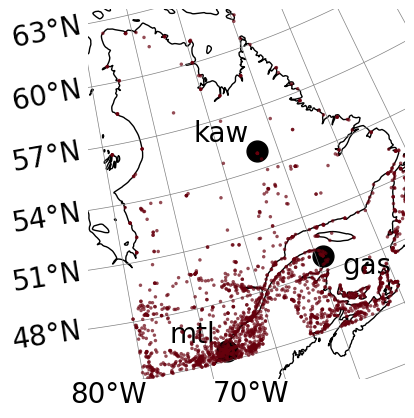

In [16]:
import urllib
import geopandas as gpd
from urlpath import URL


#use a bounding box to limit zone of interest
lat_bnds = [45, 65]
lon_bnds = [-80, -55]

freq = 'HLY'

# Compose the request
url = URL(f"https://api.weather.gc.ca/collections/climate-stations/items?&limit=1500000000&bbox={min(lon_bnds)},{min(lat_bnds)},{max(lon_bnds)},{max(lat_bnds)}")
# # Send the request to the server
resp = url.get()
# resp
with urllib.request.urlopen(url=str(url)) as req:
    stations = gpd.read_file(filename=req).to_crs('epsg:4326')

print(f'found {len(stations)} station descriptions... filtering ')
stations['lon'] = stations.geometry.x
stations['lat'] = stations.geometry.y
dsC = xr.Dataset.from_dataframe(stations)
dsC = dsC.set_coords(['lat', 'lon'])


dsC_qc= xs.spatial.subset(dsC, method='bbox',name='qc',lon_bnds= [ -83, -55 ],lat_bnds= [ 42, 63 ])
ax=fg.scattermap(dsC_qc['STN_ID'],
              features=['coastline'],
            projection=ccrs.LambertConformal(),
              cmap='Reds',
              plot_kw={'s':25, 'marker':'.','vmin':0,'vmax':50,"add_colorbar":False,'alpha':0.7}
             )
ax.plot(-73.6, 45.5, '.', markersize=30, color='black', transform=ccrs.PlateCarree())
ax.text(-77.6, 46.6, 'mtl', fontsize=20, transform=ccrs.PlateCarree())
ax.plot(-64.5, 48.8, '.', markersize=30, color='black', transform=ccrs.PlateCarree())
ax.text(-63.5, 47.56, 'gas', fontsize=20, transform=ccrs.PlateCarree())
ax.plot(-66.8, 54.9, '.', markersize=30, color='black', transform=ccrs.PlateCarree())
ax.text(-71.9, 56.3, 'kaw', fontsize=20, transform=ccrs.PlateCarree())



        
ax.set_extent([-80,-60, 45, 61], crs=ccrs.PlateCarree())

gl=ax.gridlines( draw_labels=True,color='gray',x_inline=False, y_inline=False)
gl.xlabel_style = {'size': 20, 'rotation':0}
gl.ylabel_style = {'size': 20}
gl.top_labels = False
gl.right_labels = False

plt.savefig(f"{CONFIG['paths']['figures']}stations.pdf", bbox_inches='tight')


# not shown

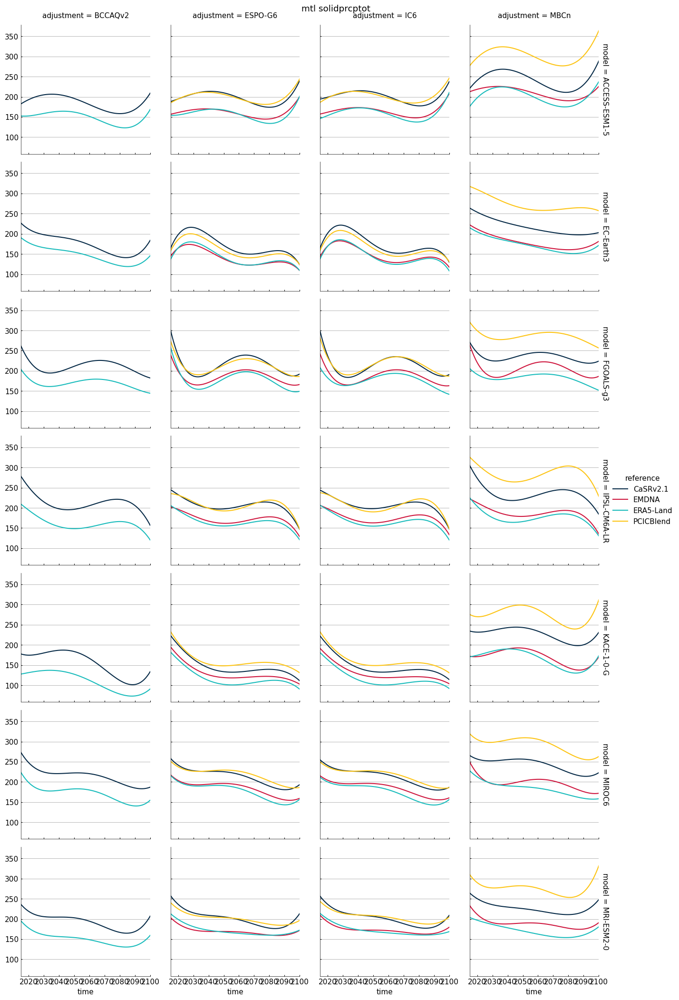

In [17]:
# MBCn drive diff in solidprcptot
point='mtl'
point_dict=CONFIG['gridpoints'][point]
ens_part = pcat.search(processing_level='partition-ensemble7442', domain=point).to_dataset(**tdd)
for var in ['solidprcptot']:
    da=ens_part[var]

    fit = da.polyfit(dim="time", deg=4, skipna=True)
    sm = xr.polyval(coord=da.time, coeffs=fit.polyfit_coefficients).where(
        da.notnull()
    )
    grid=sm.isel(scenario=0).plot(row='model',hue='reference', col='adjustment')
    grid.fig.suptitle(f"{point} {var}", y=1)
